In [1]:
import pandas as pd
import matplotlib.pyplot as plt
#import seaborn as sns
import numpy as np
import sys
! {sys.executable} -m pip install openpyxl
import warnings
warnings.filterwarnings('ignore')

## Reading in the School Data (tvaas_df, lettergrade_df, act_df, gradrate_df, wida_df)

## 2023-2024 WIDA Report (EL Students)

In [4]:
wida_df = pd.read_excel('../data/wida_growth_standard_school_suppressed_2024.xlsx')

In [5]:
wida_df.head(1)

,system,system_name,school,school_name,student_group,exit_denom,n_exit,pct_exit,growth_standard_denom,n_met_growth_standard,pct_met_growth_standard,literacy_average,composite_average
0,10,Anderson County,2,Anderson County High School,All Students,10,1,10,8,*,*,3.5,3.5


In [6]:
wida_df['system_name'].unique()

array(['Anderson County', 'Clinton', 'Oak Ridge', 'Bedford County',
       'Benton County', 'Bledsoe County', 'Blount County', 'Alcoa',
       'Maryville', 'Bradley County', 'Cleveland', 'Campbell County',
       'Cannon County', 'Hollow Rock - Bruceton',
       'Huntingdon Special School District', 'McKenzie', 'South Carroll',
       'West Carroll Sp Dist', 'Carter County', 'Elizabethton',
       'Cheatham County', 'Chester County', 'Claiborne County',
       'Clay County', 'Cocke County', 'Newport', 'Coffee County',
       'Manchester', 'Tullahoma', 'Crockett County', 'Alamo', 'Bells',
       'Cumberland County', 'Davidson County', 'Decatur County',
       'DeKalb County', 'Dickson County', 'Dyer County', 'Dyersburg',
       'Fayette County Public Schools', 'Fentress County',
       'Franklin County', 'Humboldt City Schools', 'Milan', 'Trenton',
       'Bradford', 'Gibson Co Sp Dist', 'Giles County', 'Grainger County',
       'Greene County', 'Greeneville', 'Grundy County', 'Hamblen 

In [7]:
wida_mnps_df = wida_df[wida_df['system_name'].str.lower() == 'davidson county']

In [8]:
wida_mnps_df.reset_index(drop=True, inplace=True)

In [9]:
wida_mnps_df.drop('system_name', axis=1, inplace=True)

In [10]:
wida_mnps_df.drop('system', axis=1, inplace=True)

In [11]:
wida_mnps_df.columns = ['school_number', 'school_name', 'wida_student_group', 'wida_exit_denom', 'wida_n_exit', 'wida_pct_exit', 'wida_growth_standard_denom', 'wida_n_met_growth_standard', 'wida_pct_met_growth_standard', 'wida_literacy_avg', 'wida_comp_avg'] 

In [12]:
wida_mnps_df.shape

(1683, 11)

In [13]:
wida_mnps_df.head()

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg
0,1,A. Z. Kelley Elementary,All Students,304,**,**,189,80,42.3,2.6,2.8
1,1,A. Z. Kelley Elementary,Asian,65,4,6.2,44,19,43.2,2.8,3
2,1,A. Z. Kelley Elementary,Black or African American,45,4,8.9,24,14,58.3,2.7,3.1
3,1,A. Z. Kelley Elementary,Black/Hispanic/Native American,200,**,**,116,52,44.8,2.5,2.7
4,1,A. Z. Kelley Elementary,Economically Disadvantaged,89,**,**,50,22,44,2.5,2.7


In [14]:
wida_mnps_byschool_allstudents = wida_mnps_df[wida_mnps_df['wida_student_group'].str.lower() == 'all students']

In [15]:
wida_mnps_byschool_allstudents

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg
0,1,A. Z. Kelley Elementary,All Students,304,**,**,189,80,42.3,2.6,2.8
12,3,MNPS Virtual School,All Students,4,*,*,3,*,*,*,*
21,5,Alex Green Elementary,All Students,70,5,7.1,47,20,42.6,2.8,2.9
33,10,Amqui Elementary,All Students,195,16,8.2,124,65,52.4,2.7,2.8
44,15,Andrew Jackson Elementary,All Students,45,**,**,32,16,50,2.8,3.1
...,...,...,...,...,...,...,...,...,...,...,...
1626,8085,KIPP Nashville College Prep Elementary,All Students,28,2,7.1,24,13,54.2,2.9,3.2
1638,8090,Strive Collegiate Academy,All Students,18,1,5.6,17,4,23.5,3,3.2
1649,8095,KIPP Academy Nashville Elementary School,All Students,19,**,**,13,7,53.8,2.8,3.1
1660,8100,RePublic High School,All Students,94,**,**,85,14,16.5,3.2,3.1


In [16]:
charter_schools = [
    'Cameron College Prep'
    'Smithson Craighead Academy',
    'KIPP Academy Nashville', 
    'LEAD Academy',
    'Liberty Collegiate Academy', 
    'STEM Prep Academy',
    'Nashville Prep', 
    'East End Preparatory School', 'LEAD Cameron',
    'KIPP Nashville Collegiate High School', 
    'LEAD Southeast',
    'KIPP Nashville College Prep', 
    'Nashville Classical East',
    'Nashville Classical West', 
    'Aventura Community School'
    'Valor Flagship Academy', 
    'Purpose Prep',
    'Intrepid College Preparatory Charter School',
    'Rocketship Nashville Northeast Elementary',
    'Explore Community School', 
    'Rocketship United',
    'STEM Prep High School', 
    'Valor Voyager Academy',
    'KIPP Nashville College Prep Elementary',
    'Strive Collegiate Academy',
    'KIPP Academy Nashville Elementary School', 
    'Knowledge Academies HS',
    'RePublic High School',
    'KA @ The Crossings (8110)'
    'KIPP Academy Nashville Elementary School' 
    'Purpose Prep', 
    'Smithson Craighead Academy',
    'Valor Flagship Academy',
    'KA @ The Crossings (8110)',
    'Aventura Community School',
    'KA @ The Crossings',
    'Lead Academy'
]

In [17]:
wida_nocharters = wida_mnps_byschool_allstudents[~wida_mnps_byschool_allstudents['school_name'].isin(charter_schools)]

In [18]:
wida_nocharters.shape

(123, 11)

In [19]:
wida_nocharters['school_name'].unique()

array(['A. Z. Kelley Elementary', 'MNPS Virtual School',
       'Alex Green Elementary', 'Amqui Elementary',
       'Andrew Jackson Elementary', 'Antioch High School',
       'Antioch Middle', 'Apollo Middle', 'Moses McKissack Middle',
       'Bellevue Middle', 'Bellshire Elementary',
       'Nashville Big Picture High School', 'Cane Ridge High School',
       'Ida B. Wells Elementary', 'Cane Ridge Elementary',
       'Chadwell Elementary', 'Charlotte Park Elementary',
       'Eagle View Elementary School', 'Cockrill Elementary',
       'W. A. Bass Adult Program',
       'W.A. Bass Alternative Learning Center', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'East Nashville Magnet High School', 'Thomas A. Edison Elementary',
       'Fall

In [20]:
wida_nocharters.reset_index(drop=True, inplace=True)

In [21]:
wida_nocharters

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg
0,1,A. Z. Kelley Elementary,All Students,304,**,**,189,80,42.3,2.6,2.8
1,3,MNPS Virtual School,All Students,4,*,*,3,*,*,*,*
2,5,Alex Green Elementary,All Students,70,5,7.1,47,20,42.6,2.8,2.9
3,10,Amqui Elementary,All Students,195,16,8.2,124,65,52.4,2.7,2.8
4,15,Andrew Jackson Elementary,All Students,45,**,**,32,16,50,2.8,3.1
...,...,...,...,...,...,...,...,...,...,...,...
118,720,The Academy at Hickory Hollow,All Students,4,*,*,3,*,*,*,*
119,725,Transitions at Bass,All Students,2,*,*,2,*,*,*,*
120,740,Johnson Alternative Learning Center,All Students,26,**,**,23,3,13,2.5,2.6
121,750,Smith Springs Elementary School,All Students,267,24,9,175,86,49.1,2.8,2.9


## 2023-2024 TVAAS Report

In [23]:
tvaas_df = pd.read_excel('../data/2024_tvaas_school_composite.xlsx')

In [24]:
tvaas_df

,District Number,School Number,District Name,School Name,Overall Composite,Literacy Composite,Numeracy Composite,Literacy and Numeracy Composite,Science Composite,Social Studies Composite
0,10,10,Anderson County,Briceville Elementary,2,3.0,1.0,1.0,3.0,NaN
1,10,15,Anderson County,Claxton Elementary,3,3.0,2.0,3.0,5.0,NaN
2,10,2,Anderson County,Anderson County High School,1,1.0,3.0,1.0,3.0,NaN
3,10,20,Anderson County,Clinton Middle School,1,1.0,1.0,1.0,1.0,2.0
4,10,25,Anderson County,Clinton High School,5,5.0,5.0,5.0,4.0,NaN
...,...,...,...,...,...,...,...,...,...,...
1723,987,8070,Tennessee Public Charter School Commission,Lester Prep,5,5.0,5.0,5.0,5.0,5.0
1724,987,8090,Tennessee Public Charter School Commission,LEAD Neely's Bend,5,5.0,5.0,5.0,5.0,5.0
1725,987,8095,Tennessee Public Charter School Commission,Libertas,5,5.0,5.0,5.0,4.0,NaN
1726,987,8115,Tennessee Public Charter School Commission,Cornerstone Prep Denver Campus,5,5.0,5.0,5.0,4.0,NaN


In [25]:
tvaas_df['District Name'].unique()

array(['Anderson County', 'Carter County', 'Elizabethton', 'Clinton',
       'Cheatham County', 'Oak Ridge', 'Chester County',
       'Claiborne County', 'Clay County', 'Cocke County', 'Newport',
       'Coffee County', 'Manchester', 'Tullahoma', 'Crockett County',
       'Alamo', 'Bells', 'Cumberland County', 'Davidson County',
       'Bedford County', 'Decatur County', 'DeKalb County',
       'Dickson County', 'Dyer County', 'Dyersburg',
       'Fayette County Public Schools', 'Fentress County',
       'Franklin County', 'Humboldt City Schools', 'Milan', 'Trenton',
       'Bradford', 'Gibson Co Sp Dist', 'Giles County', 'Grainger County',
       'Benton County', 'Greene County', 'Greeneville', 'Grundy County',
       'Hamblen County', 'Hamilton County', 'Hancock County',
       'Hardeman County Schools', 'Hardin County', 'Hawkins County',
       'Rogersville', 'Haywood County', 'Henderson County', 'Lexington',
       'Bledsoe County', 'Henry County', 'Paris', 'Hickman County',
      

## Filtering to only include Davidson County, then dropping district number/district name columns

In [27]:
tvaas_mnps_df = tvaas_df[tvaas_df['District Name'].str.lower() == 'davidson county']

In [28]:
tvaas_mnps_df.reset_index(drop=True, inplace=True)

In [29]:
tvaas_mnps_df

,District Number,School Number,District Name,School Name,Overall Composite,Literacy Composite,Numeracy Composite,Literacy and Numeracy Composite,Science Composite,Social Studies Composite
0,190,1,Davidson County,A. Z. Kelley Elementary,5,5.0,5.0,5.0,NaN,NaN
1,190,10,Davidson County,Amqui Elementary,4,5.0,3.0,5.0,3.0,3.0
2,190,105,Davidson County,Chadwell Elementary,3,3.0,3.0,3.0,3.0,NaN
3,190,110,Davidson County,Charlotte Park Elementary,3,3.0,3.0,3.0,2.0,NaN
4,190,115,Davidson County,Eagle View Elementary School,5,5.0,5.0,5.0,3.0,NaN
...,...,...,...,...,...,...,...,...,...,...
141,190,8090,Davidson County,Strive Collegiate Academy,4,3.0,5.0,5.0,3.0,3.0
142,190,8095,Davidson County,KIPP Academy Nashville Elementary School,3,3.0,3.0,3.0,NaN,NaN
143,190,8100,Davidson County,RePublic High School,5,5.0,5.0,5.0,4.0,4.0
144,190,8110,Davidson County,KA @ The Crossings (8110),3,5.0,3.0,5.0,3.0,3.0


In [30]:
tvaas_mnps_df.drop('District Number', axis=1, inplace=True)

In [31]:
tvaas_mnps_df.drop('District Name', axis=1, inplace=True)

In [32]:
tvaas_mnps_df.head()

,School Number,School Name,Overall Composite,Literacy Composite,Numeracy Composite,Literacy and Numeracy Composite,Science Composite,Social Studies Composite
0,1,A. Z. Kelley Elementary,5,5.0,5.0,5.0,NaN,NaN
1,10,Amqui Elementary,4,5.0,3.0,5.0,3.0,3.0
2,105,Chadwell Elementary,3,3.0,3.0,3.0,3.0,NaN
3,110,Charlotte Park Elementary,3,3.0,3.0,3.0,2.0,NaN
4,115,Eagle View Elementary School,5,5.0,5.0,5.0,3.0,NaN


In [33]:
tvaas_mnps_df.columns = ['school_number', 'school_name', 'tvaas_overall_comp', 'tvaas_lit_comp', 'tvaas_num_comp', 'tvaas_litandnum_comp', 'tvaas_sci_comp', 'tvaas_ss_comp']

In [34]:
tvaas_mnps_df.shape

(146, 8)

In [35]:
tvaas_mnps_df['school_name'].unique()

array(['A. Z. Kelley Elementary', 'Amqui Elementary',
       'Chadwell Elementary', 'Charlotte Park Elementary',
       'Eagle View Elementary School', 'Cockrill Elementary',
       'W.A. Bass Alternative Learning Center', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Andrew Jackson Elementary',
       'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'Antioch High School', 'East Nashville Magnet High School',
       'Thomas A. Edison Elementary', 'Fall-Hamilton Elementary',
       'Antioch Middle', 'Gateway Elementary', 'Glencliff Elementary',
       'Glencliff High School', 'Apollo Middle', 'Glendale Elementary',
       'Glengarry Elementary', 'Glenview Elementary',
       'Goodlettsville Elementary', 'Goodlettsville Middle',
       'Gower Elementary', 'Granbery Elementary', 'H. G.

## dropping charter schools

In [37]:
tvaas_nocharters = tvaas_mnps_df[~tvaas_mnps_df['school_name'].isin(charter_schools)]

In [38]:
tvaas_nocharters['school_name'].unique()

array(['A. Z. Kelley Elementary', 'Amqui Elementary',
       'Chadwell Elementary', 'Charlotte Park Elementary',
       'Eagle View Elementary School', 'Cockrill Elementary',
       'W.A. Bass Alternative Learning Center', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Andrew Jackson Elementary',
       'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'Antioch High School', 'East Nashville Magnet High School',
       'Thomas A. Edison Elementary', 'Fall-Hamilton Elementary',
       'Antioch Middle', 'Gateway Elementary', 'Glencliff Elementary',
       'Glencliff High School', 'Apollo Middle', 'Glendale Elementary',
       'Glengarry Elementary', 'Glenview Elementary',
       'Goodlettsville Elementary', 'Goodlettsville Middle',
       'Gower Elementary', 'Granbery Elementary', 'H. G.

In [39]:
tvaas_nocharters.shape

(121, 8)

## 2023-2024 Letter Grade Report

In [41]:
lettergrade_df = pd.read_excel('../data/2023-24_A-F_Letter_Grade_File (1).xlsx')

In [42]:
lettergrade_df

,year,system,system_name,school,school_name,lg_ineligible,school_pool,grade_band_3-5,grade_band_6-8,grade_band_9-12,...,ccr_asvab_rate,ccr_rate_ed,ccr_rate_el,ccr_rate_swd,ccr_rate_aian,ccr_rate_asian,ccr_rate_black,ccr_rate_hispanic,ccr_rate_nhpi,ccr_rate_white
0,2024,10,Anderson County,2,Anderson County High School,0,HS,N,N,Y,...,6.4,58.1,Insufficient N Count,47.4,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,73.8
1,2024,10,Anderson County,3,Anderson County Career Technical Center,1,K8,N,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
2,2024,10,Anderson County,4,Anderson County Innovation Academy,1,K8,N,N,Y,...,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count
3,2024,10,Anderson County,5,Andersonville Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
4,2024,10,Anderson County,10,Briceville Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1900,2024,987,Tennessee Public Charter School Commission,8070,Lester Prep,0,K8,N,Y,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
1901,2024,987,Tennessee Public Charter School Commission,8090,LEAD Neely's Bend,0,K8,Y,Y,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
1902,2024,987,Tennessee Public Charter School Commission,8095,Libertas,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
1903,2024,987,Tennessee Public Charter School Commission,8115,Cornerstone Prep Denver Campus,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School


In [43]:
lettergrade_df['system_name'].unique()	

array(['Anderson County', 'Clinton', 'Oak Ridge', 'Bedford County',
       'Benton County', 'Bledsoe County', 'Blount County', 'Alcoa',
       'Maryville', 'Bradley County', 'Cleveland', 'Campbell County',
       'Cannon County', 'Carroll County', 'Hollow Rock - Bruceton',
       'Huntingdon Special School District', 'McKenzie', 'South Carroll',
       'West Carroll Sp Dist', 'Carter County', 'Elizabethton',
       'Cheatham County', 'Chester County', 'Claiborne County',
       'Clay County', 'Cocke County', 'Newport', 'Coffee County',
       'Manchester', 'Tullahoma', 'Crockett County', 'Alamo', 'Bells',
       'Cumberland County', 'Metro Nashville Public Schools',
       'Decatur County', 'DeKalb County', 'Dickson County', 'Dyer County',
       'Dyersburg', 'Fayette County Public Schools', 'Fentress County',
       'Franklin County', 'Humboldt City Schools', 'Milan', 'Trenton',
       'Bradford', 'Gibson Co Sp Dist', 'Giles County', 'Grainger County',
       'Greene County', 'Greenev

In [44]:
lettergrade_mnps_df = lettergrade_df[lettergrade_df['system_name'].str.lower() == 'metro nashville public schools']

In [45]:
lettergrade_mnps_df

,year,system,system_name,school,school_name,lg_ineligible,school_pool,grade_band_3-5,grade_band_6-8,grade_band_9-12,...,ccr_asvab_rate,ccr_rate_ed,ccr_rate_el,ccr_rate_swd,ccr_rate_aian,ccr_rate_asian,ccr_rate_black,ccr_rate_hispanic,ccr_rate_nhpi,ccr_rate_white
265,2024,190,Metro Nashville Public Schools,1,A. Z. Kelley Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
266,2024,190,Metro Nashville Public Schools,3,MNPS Virtual School,0,HS,Y,Y,Y,...,<5%,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count
267,2024,190,Metro Nashville Public Schools,5,Alex Green Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
268,2024,190,Metro Nashville Public Schools,10,Amqui Elementary,0,K8,Y,Y,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
269,2024,190,Metro Nashville Public Schools,15,Andrew Jackson Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,2024,190,Metro Nashville Public Schools,8085,KIPP Nashville College Prep Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
423,2024,190,Metro Nashville Public Schools,8090,Strive Collegiate Academy,0,K8,N,Y,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
424,2024,190,Metro Nashville Public Schools,8095,KIPP Kirkpatrick Elementary School,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
425,2024,190,Metro Nashville Public Schools,8100,RePublic High School,0,HS,N,N,Y,...,<5%,25,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,30.2,39.4,Insufficient N Count,Insufficient N Count


In [46]:
lettergrade_mnps_df.columns

Index(['year', 'system', 'system_name', 'school', 'school_name',
       'lg_ineligible', 'school_pool', 'grade_band_3-5', 'grade_band_6-8',
       'grade_band_9-12', 'ach_score', 'growth_score', 'growth25_score',
       'ccr_score', 'ach_grade', 'growth_grade', 'growth25_grade', 'ccr_grade',
       'ach_score_weighted', 'growth_score_weighted',
       'growth25_score_weighted', 'ccr_score_weighted', 'ach_weight',
       'growth_weight', 'growth25_weight', 'ccr_weight', 'lg_score',
       'lg_grade', 'overall_success_rate_all_students',
       'overall_success_rate_ed', 'overall_success_rate_el',
       'overall_success_rate_swd', 'overall_success_rate_aian',
       'overall_success_rate_asian', 'overall_success_rate_black',
       'overall_success_rate_hispanic', 'overall_success_rate_nhpi',
       'overall_success_rate_white', 'success_rate_g3-5_ela',
       'success_rate_g3-5_math', 'success_rate_g3-5_science',
       'success_rate_g6-8_ela', 'success_rate_g6-8_math',
       'success

In [47]:
lettergrade_mnps_df.head(2)

,year,system,system_name,school,school_name,lg_ineligible,school_pool,grade_band_3-5,grade_band_6-8,grade_band_9-12,...,ccr_asvab_rate,ccr_rate_ed,ccr_rate_el,ccr_rate_swd,ccr_rate_aian,ccr_rate_asian,ccr_rate_black,ccr_rate_hispanic,ccr_rate_nhpi,ccr_rate_white
265,2024,190,Metro Nashville Public Schools,1,A. Z. Kelley Elementary,0,K8,Y,N,N,...,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School,Not a High School
266,2024,190,Metro Nashville Public Schools,3,MNPS Virtual School,0,HS,Y,Y,Y,...,<5%,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count,Insufficient N Count


In [48]:
lettergrade_mnps_df = lettergrade_mnps_df[['school', 'school_name', 'ach_grade']]

In [49]:
lettergrade_mnps_df

,school,school_name,ach_grade
265,1,A. Z. Kelley Elementary,D
266,3,MNPS Virtual School,D
267,5,Alex Green Elementary,F
268,10,Amqui Elementary,D
269,15,Andrew Jackson Elementary,B
...,...,...,...
422,8085,KIPP Nashville College Prep Elementary,D
423,8090,Strive Collegiate Academy,D
424,8095,KIPP Kirkpatrick Elementary School,F
425,8100,RePublic High School,D


In [50]:
lettergrade_mnps_df.columns = ['school_number', 'school_name', 'letter_grade']

In [51]:
lettergrade_mnps_df.head(2)

,school_number,school_name,letter_grade
265,1,A. Z. Kelley Elementary,D
266,3,MNPS Virtual School,D


In [52]:
lettergrade_mnps_df['school_name'].unique()

array(['A. Z. Kelley Elementary', 'MNPS Virtual School',
       'Alex Green Elementary', 'Amqui Elementary',
       'Andrew Jackson Elementary', 'Antioch High School',
       'Antioch Middle', 'Apollo Middle', 'Moses McKissack Middle',
       'Bellevue Middle', 'Bellshire Elementary',
       'Nashville Big Picture High School', 'Cane Ridge High School',
       'Ida B. Wells Elementary', 'Cane Ridge Elementary',
       'Chadwell Elementary', 'Charlotte Park Elementary',
       'Eagle View Elementary School', 'Cockrill Elementary',
       'W. A. Bass Adult Program',
       'W.A. Bass Alternative Learning Center', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'East Nashville Magnet High School', 'Thomas A. Edison Elementary',
       'Fall

In [53]:
lettergrade_mnps_df.reset_index(drop=True, inplace=True)

In [54]:
lettergrade_mnps_df

,school_number,school_name,letter_grade
0,1,A. Z. Kelley Elementary,D
1,3,MNPS Virtual School,D
2,5,Alex Green Elementary,F
3,10,Amqui Elementary,D
4,15,Andrew Jackson Elementary,B
...,...,...,...
157,8085,KIPP Nashville College Prep Elementary,D
158,8090,Strive Collegiate Academy,D
159,8095,KIPP Kirkpatrick Elementary School,F
160,8100,RePublic High School,D


In [55]:
lettergrade_mnps_nocharters = lettergrade_mnps_df[~lettergrade_mnps_df['school_name'].isin(charter_schools)]

In [56]:
lettergrade_mnps_nocharters

,school_number,school_name,letter_grade
0,1,A. Z. Kelley Elementary,D
1,3,MNPS Virtual School,D
2,5,Alex Green Elementary,F
3,10,Amqui Elementary,D
4,15,Andrew Jackson Elementary,B
...,...,...,...
131,7005,Cambridge Early Learning Center,Insufficient N Count
132,7010,Ivanetta H. Davis Learning Center at Bordeaux,Insufficient N Count
133,7015,Ross Early Learning Center,Insufficient N Count
134,7020,Casa Azafran Early Learning Center,Insufficient N Count


## ACT Reports

In [58]:
act_df = pd.read_excel('../data/2023-24_ACT_school_suppressed.xlsx')

In [59]:
act_df

,District,District Name,School,School Name,Subgroup,Valid Tests,Participation Rate,Average English Score,Average Math Score,Average Reading Score,Average Science Score,Average Composite Score,Number Scoring 21 or Higher,Percent Scoring 21 or Higher,Number Scoring Below 19,Percent Scoring Below 19
0,10,Anderson County,2,Anderson County High School,All Students,244,100,17.6,18.4,19.1,19,18.7,92,37.7,124,50.8
1,10,Anderson County,2,Anderson County High School,Black/Hispanic/Native American,14,100,17.9,19.6,19.6,19.8,19.5,7,50,5,35.7
2,10,Anderson County,2,Anderson County High School,Economically Disadvantaged,61,100,14.6,17,15.9,16.3,16.1,11,18,43,70.5
3,10,Anderson County,2,Anderson County High School,English Learners,3,*,*,*,*,*,*,*,*,*,*
4,10,Anderson County,2,Anderson County High School,Students with Disabilities,36,100,12.3,14.7,13.4,14.5,13.8,**,**,**,**
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1867,987,Tennessee Public Charter School Commission,8005,Bluff City High School,All Students,83,100,12.7,15,14.6,15.1,14.5,**,**,**,**
1868,987,Tennessee Public Charter School Commission,8005,Bluff City High School,Black/Hispanic/Native American,81,100,12.7,15,14.4,15,14.4,**,**,**,**
1869,987,Tennessee Public Charter School Commission,8005,Bluff City High School,Economically Disadvantaged,63,100,12.7,14.9,14.5,15,14.4,**,**,**,**
1870,987,Tennessee Public Charter School Commission,8005,Bluff City High School,English Learners,11,100,10.6,14.9,13.3,13.5,13.3,**,**,**,**


In [60]:
act_df['District Name'].unique()

array(['Anderson County', 'Oak Ridge', 'Bedford County', 'Benton County',
       'Bledsoe County', 'Blount County', 'Alcoa', 'Maryville',
       'Bradley County', 'Cleveland', 'Campbell County', 'Cannon County',
       'Hollow Rock - Bruceton', 'Huntingdon Special School District',
       'McKenzie', 'South Carroll', 'West Carroll Sp Dist',
       'Carter County', 'Elizabethton', 'Cheatham County',
       'Chester County', 'Claiborne County', 'Clay County',
       'Cocke County', 'Coffee County', 'Tullahoma', 'Crockett County',
       'Cumberland County', 'Davidson County', 'Decatur County',
       'DeKalb County', 'Dickson County', 'Dyer County', 'Dyersburg',
       'Fayette County Public Schools', 'Fentress County',
       'Franklin County', 'Humboldt City Schools', 'Milan', 'Trenton',
       'Bradford', 'Gibson Co Sp Dist', 'Giles County', 'Grainger County',
       'Greene County', 'Greeneville', 'Grundy County', 'Hamblen County',
       'Hamilton County', 'Hancock County', 'Hardema

In [61]:
act_mnps_df = act_df[act_df['District Name'].str.lower() == 'davidson county']

In [62]:
act_mnps_df

,District,District Name,School,School Name,Subgroup,Valid Tests,Participation Rate,Average English Score,Average Math Score,Average Reading Score,Average Science Score,Average Composite Score,Number Scoring 21 or Higher,Percent Scoring 21 or Higher,Number Scoring Below 19,Percent Scoring Below 19
238,190,Davidson County,3,MNPS Virtual School,All Students,34,100,19.9,17.7,19.7,18.8,19.2,12,35.3,18,52.9
239,190,Davidson County,3,MNPS Virtual School,Black/Hispanic/Native American,15,100,17.3,16.2,16.3,15.9,16.6,3,20,12,80
240,190,Davidson County,3,MNPS Virtual School,Economically Disadvantaged,9,*,*,*,*,*,*,*,*,*,*
241,190,Davidson County,3,MNPS Virtual School,English Learners,1,*,*,*,*,*,*,*,*,*,*
242,190,Davidson County,3,MNPS Virtual School,Students with Disabilities,3,*,*,*,*,*,*,*,*,*,*
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
382,190,Davidson County,8110,KA @ The Crossings,All Students,47,98,14.4,15.6,15.1,15.9,15.3,4,8.5,40,85.1
383,190,Davidson County,8110,KA @ The Crossings,Black/Hispanic/Native American,41,98,13.8,15.3,14.5,15.5,14.9,**,**,**,**
384,190,Davidson County,8110,KA @ The Crossings,Economically Disadvantaged,21,95,13.2,15.2,14.5,15.6,14.8,**,**,**,**
385,190,Davidson County,8110,KA @ The Crossings,English Learners,18,95,12.1,14.5,12.4,15.1,13.6,**,**,**,**


In [63]:
act_mnps_df.drop('District', axis=1, inplace=True)

In [64]:
act_mnps_df.drop('District Name', axis=1, inplace=True)

In [65]:
act_mnps_df.reset_index(drop=True, inplace=True)

In [66]:
act_mnps_df.head()

,School,School Name,Subgroup,Valid Tests,Participation Rate,Average English Score,Average Math Score,Average Reading Score,Average Science Score,Average Composite Score,Number Scoring 21 or Higher,Percent Scoring 21 or Higher,Number Scoring Below 19,Percent Scoring Below 19
0,3,MNPS Virtual School,All Students,34,100,19.9,17.7,19.7,18.8,19.2,12,35.3,18,52.9
1,3,MNPS Virtual School,Black/Hispanic/Native American,15,100,17.3,16.2,16.3,15.9,16.6,3,20,12,80
2,3,MNPS Virtual School,Economically Disadvantaged,9,*,*,*,*,*,*,*,*,*,*
3,3,MNPS Virtual School,English Learners,1,*,*,*,*,*,*,*,*,*,*
4,3,MNPS Virtual School,Students with Disabilities,3,*,*,*,*,*,*,*,*,*,*


In [67]:
act_mnps_df.columns = ['school_number', 'school_name', 'act_subgroup', 'act_validtests', 'act_part_rate', 'act_avg_eng', 'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp', 'num_scoring_21orhigher', 'pct_scoring_21orhigher', 'num_scoring_below19', 'pct_scoring_below19']

In [68]:
act_mnps_df.head(2)

,school_number,school_name,act_subgroup,act_validtests,act_part_rate,act_avg_eng,act_avg_math,act_avg_reading,act_avg_sci,act_avg_comp,num_scoring_21orhigher,pct_scoring_21orhigher,num_scoring_below19,pct_scoring_below19
0,3,MNPS Virtual School,All Students,34,100,19.9,17.7,19.7,18.8,19.2,12,35.3,18,52.9
1,3,MNPS Virtual School,Black/Hispanic/Native American,15,100,17.3,16.2,16.3,15.9,16.6,3,20,12,80


In [69]:
act_mnps_df['school_name'].nunique()

31

## Creating Separate ACT DF that shows data by school for ALL students, instead of by subgroup; then dropping the act_subgroup column

In [71]:
act_mnps_byschool_allstudents = act_mnps_df[act_mnps_df['act_subgroup'].str.lower() == 'all students']

In [72]:
act_mnps_byschool_allstudents.reset_index(drop=True, inplace=True)

In [73]:
act_mnps_byschool_allstudents.drop('act_subgroup', axis=1, inplace=True)

In [74]:
act_mnps_byschool_allstudents['school_name'].nunique()

31

## Graduation Rate 

In [76]:
gradrate_df = pd.read_excel('../data/2023-24_school_grad_rate_suppressed.xlsx')

In [77]:
mnps_gradrate_df = gradrate_df[gradrate_df['system_name']=='Davidson County']

In [78]:
mnps_gradrate_df

,graduation_year,system,system_name,school,school_name,student_group,grad_cohort_state,grad_count_state,grad_rate_state,grad_cohort_federal,grad_count_federal,grad_rate_federal
1042,2024,190,Davidson County,3,MNPS Virtual School,All Students,35,**,**,35,**,**
1043,2024,190,Davidson County,3,MNPS Virtual School,American Indian or Alaska Native,1,*,*,1,*,*
1044,2024,190,Davidson County,3,MNPS Virtual School,Asian,1,*,*,1,*,*
1045,2024,190,Davidson County,3,MNPS Virtual School,Black or African American,13,**,**,13,**,**
1046,2024,190,Davidson County,3,MNPS Virtual School,Black/Hispanic/Native American,16,**,**,16,**,**
...,...,...,...,...,...,...,...,...,...,...,...,...
1686,2024,190,Davidson County,8110,KA @ The Crossings,Non-Homeless,47,46,97.9,47,45,95.7
1687,2024,190,Davidson County,8110,KA @ The Crossings,Non-Migrant,49,48,98,49,47,95.9
1688,2024,190,Davidson County,8110,KA @ The Crossings,Non-Students with Disabilities,37,36,97.3,37,36,97.3
1689,2024,190,Davidson County,8110,KA @ The Crossings,Students with Disabilities,12,**,**,12,11,91.7


## Create filtered df to show only 'all students', then drop columns

In [80]:
gradrate_mnps_byschool_allstudents = mnps_gradrate_df[mnps_gradrate_df['student_group'].str.lower() == 'all students']

In [81]:
gradrate_mnps_byschool_allstudents.head()

,graduation_year,system,system_name,school,school_name,student_group,grad_cohort_state,grad_count_state,grad_rate_state,grad_cohort_federal,grad_count_federal,grad_rate_federal
1042,2024,190,Davidson County,3,MNPS Virtual School,All Students,35,**,**,35,**,**
1060,2024,190,Davidson County,20,Antioch High School,All Students,558,444,79.6,558,425,76.2
1081,2024,190,Davidson County,53,Nashville Big Picture High School,All Students,35,**,**,35,**,**
1095,2024,190,Davidson County,77,Cane Ridge High School,All Students,483,385,79.7,483,377,78.1
1116,2024,190,Davidson County,203,East Nashville Magnet High School,All Students,127,121,95.3,127,121,95.3


In [82]:
gradrate_mnps_byschool_allstudents.drop('graduation_year', axis=1, inplace=True)

In [83]:
gradrate_mnps_byschool_allstudents.drop('system', axis=1, inplace=True)

In [84]:
gradrate_mnps_byschool_allstudents.drop('system_name', axis=1, inplace=True)

In [85]:
gradrate_mnps_byschool_allstudents.drop('student_group', axis=1, inplace=True)

In [86]:
gradrate_mnps_byschool_allstudents.reset_index(drop=True, inplace=True)

In [87]:
gradrate_mnps_byschool_allstudents.head(1)

,school,school_name,grad_cohort_state,grad_count_state,grad_rate_state,grad_cohort_federal,grad_count_federal,grad_rate_federal
0,3,MNPS Virtual School,35,**,**,35,**,**


In [88]:
gradrate_mnps_byschool_allstudents.columns = ['school_number', 'school_name', 'hs_grad_cohort_state', 'hs_grad_count_state', 'hs_grad_rate_state', 'hs_grad_cohort_federal', 'hs_grad_count_federal', 'hs_grad_rate_federal']

In [89]:
gradrate_mnps_byschool_allstudents.head(1)

,school_number,school_name,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal
0,3,MNPS Virtual School,35,**,**,35,**,**


In [90]:
gradrate_mnps_byschool_allstudents['school_name'].nunique()

35

## Lists (School Type)

In [92]:
elementary_schools = [
    'A. Z. Kelley Elementary',
    'Amqui Elementary',
    'Chadwell Elementary',
    'Charlotte Park Elementary',
    'Eagle View Elementary School',
    'Cockrill Elementary',
    'Cole Elementary',
    'Hattie Cotton Elementary',
    'Crieve Hall Elementary',
    'Andrew Jackson Elementary',
    'Cumberland Elementary',
    'Dan Mills Elementary',
    'Dodson Elementary',
    'DuPont Elementary',
    'Eakin Elementary',
    'Thomas A. Edison Elementary',
    'Fall-Hamilton Elementary',
    'Gateway Elementary',
    'Glencliff Elementary',
    'Glendale Elementary',
    'Glengarry Elementary',
    'Glenview Elementary',
    'Goodlettsville Elementary',
    'Gower Elementary',
    'Granbery Elementary',
    'Harpeth Valley Elementary',
    'Haywood Elementary',
    'Henry C. Maxwell Elementary',
    'Hermitage Elementary',
    'Hickman Elementary',
    'Hull-Jackson Elementary',
    'Inglewood Elementary',
    'J. E. Moss Elementary',
    'Joelton Elementary',
    'Jones Elementary',
    'John B. Whitsitt Elementary',
    'Julia Green Elementary',
    'Lakeview Elementary',
    'Lockeland Elementary',
    'Bellshire Elementary',
    'McGavock Elementary',
    'Mt. View Elementary',
    'Alex Green Elementary',
    'Napier Elementary',
    'Neely\'s Bend Elementary',
    'Norman Binkley Elementary',
    'Old Center Elementary',
    'Paragon Mills Elementary',
    'Park Avenue Elementary',
    'Pennington Elementary',
    'Percy Priest Elementary',
    'Rosebank Elementary',
    'Ruby Major Elementary',
    'May Werthan Shayne Elementary School',
    'Shwab Elementary',
    'Stanford Elementary',
    'Robert Churchwell Elementary',
    'Stratton Elementary',
    'Sylvan Park Elementary',
    'Tom Joy Elementary',
    'Tulip Grove Elementary',
    'Tusculum Elementary',
    'Una Elementary',
    'Carter-Lawrence Elementary',
    'Warner Elementary',
    'Westmeade Elementary',
    'Smith Springs Elementary School',
    'Waverly-Belmont Elementary School',
    'Ida B. Wells Elementary',
    'Cane Ridge Elementary'
]

In [93]:
middle_schools = [
    'Croft Middle',
    'Donelson Middle',
    'DuPont Tyler Middle',
    'DuPont Hadley Middle',
    'Antioch Middle',
    'Apollo Middle',
    'Goodlettsville Middle',
    'H. G. Hill Middle',
    'East Nashville Middle',
    'Haynes Middle',
    'Head Middle',
    'Isaac Litton Middle',
    'Jere Baxter Middle',
    'John Early Middle',
    'John F. Kennedy Middle',
    'Bellevue Middle',
    'Margaret Allen Middle',
    'McMurray Middle',
    'John Trotwood Moore Middle',
    'Madison Middle',
    'Rose Park Middle',
    'Thurgood Marshall Middle',
    'Two Rivers Middle',
    'West End Middle',
    'Wright Middle',
    'Isaiah T. Creswell Middle School of the Arts', 
    'Moses McKissack Middle', 
    'Meigs Middle', 
    'William Henry Oliver Middle'
]

In [94]:
high_schools = [
    'Antioch High School',
    'East Nashville Magnet High School',
    'Glencliff High School',
    'Hillsboro High',
    'Hume - Fogg High',
    'Hunters Lane High',
    'James Lawson High School',
    'John Overton High',
    'Early College High School',
    'Maplewood High',
    'McGavock High',
    'Martin Luther King Jr School',
    'Nashville School of the Arts',
    'Nashville Big Picture High School',
    'Pearl-Cohn High',
    'Stratford STEM Magnet School',
    'Whites Creek High',
    'Cane Ridge High School',
    'Hillwood High', 
    'Lawson High'
]

In [95]:
exceptional_ed = [
    'Cora Howe', 
    'Murrell at Glenn School', 
    'Harris-Hillman Special Education'
]

In [96]:
alt = [
    'MNPS Virtual School',
    'W.A. Bass Alternative Learning Center',
    'Johnson Alternative Learning Center', 
    'MNPS Virtual School'
]

In [97]:
specialty = [
    'Nashville Big Picture HS', 
    'Nashville Big Picture High School', 
    'Nashville Big Picture', 
    'The Academy at Hickory Hollow', 
    'The Academy at Old Cockrill', 
    'The Academy at Opry Mills'
]

## Trying to MERGE all DF on school_number and school_name

In [99]:
merged_df = pd.merge(
    wida_nocharters,
    tvaas_nocharters,
    on=['school_number', 'school_name'],
    how='outer',
    indicator='merge_step1'
)

In [100]:
merged_df = pd.merge(
    merged_df,
    lettergrade_mnps_nocharters,
    on=['school_number', 'school_name'],
    how='outer',
    indicator='merge_step2'
)

In [101]:
merged_df = pd.merge(
    merged_df,
    act_mnps_byschool_allstudents,
    on=['school_number', 'school_name'],
    how='outer',
    indicator='merge_step3'
)

In [102]:
merged_df = pd.merge(
    merged_df,
    gradrate_mnps_byschool_allstudents,
    on=['school_number', 'school_name'],
    how='outer',
    indicator='merge_step4'
)

In [103]:
merged_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,num_scoring_below19,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,3,MNPS Virtual School,All Students,4.0,*,*,3.0,*,*,*,...,18,52.9,both,35.0,**,**,35.0,**,**,both
2,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,8065,Knowledge Academies High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,3.0,*,*,3.0,*,*,right_only
143,8075,STEM Prep High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,72,63.7,right_only,118.0,114,96.6,118.0,114,96.6,both
144,8095,KIPP Kirkpatrick Elementary School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
145,8100,RePublic High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,70,66,right_only,127.0,110,86.6,127.0,110,86.6,both


In [104]:
merged_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,num_scoring_below19,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,3,MNPS Virtual School,All Students,4.0,*,*,3.0,*,*,*,...,18,52.9,both,35.0,**,**,35.0,**,**,both
2,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,8065,Knowledge Academies High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,3.0,*,*,3.0,*,*,right_only
143,8075,STEM Prep High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,72,63.7,right_only,118.0,114,96.6,118.0,114,96.6,both
144,8095,KIPP Kirkpatrick Elementary School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
145,8100,RePublic High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,70,66,right_only,127.0,110,86.6,127.0,110,86.6,both


In [105]:
merged_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,num_scoring_below19,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,3,MNPS Virtual School,All Students,4.0,*,*,3.0,*,*,*,...,18,52.9,both,35.0,**,**,35.0,**,**,both
2,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,8065,Knowledge Academies High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,3.0,*,*,3.0,*,*,right_only
143,8075,STEM Prep High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,72,63.7,right_only,118.0,114,96.6,118.0,114,96.6,both
144,8095,KIPP Kirkpatrick Elementary School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
145,8100,RePublic High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,70,66,right_only,127.0,110,86.6,127.0,110,86.6,both


In [106]:
merged_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,num_scoring_below19,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,3,MNPS Virtual School,All Students,4.0,*,*,3.0,*,*,*,...,18,52.9,both,35.0,**,**,35.0,**,**,both
2,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142,8065,Knowledge Academies High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,3.0,*,*,3.0,*,*,right_only
143,8075,STEM Prep High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,72,63.7,right_only,118.0,114,96.6,118.0,114,96.6,both
144,8095,KIPP Kirkpatrick Elementary School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only
145,8100,RePublic High School,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,70,66,right_only,127.0,110,86.6,127.0,110,86.6,both


## Getting rid of Charter Schools and other schools (like alternative/ex.ed)

In [108]:
merged_df_nocharters = merged_df[~merged_df['school_name'].isin(charter_schools)]

In [109]:
merged_df_nocharters['school_name'].unique()

array(['A. Z. Kelley Elementary', 'MNPS Virtual School',
       'Alex Green Elementary', 'Amqui Elementary',
       'Andrew Jackson Elementary', 'Antioch High School',
       'Antioch Middle', 'Apollo Middle', 'Moses McKissack Middle',
       'Bellevue Middle', 'Bellshire Elementary',
       'Nashville Big Picture High School', 'Cane Ridge High School',
       'Ida B. Wells Elementary', 'Cane Ridge Elementary',
       'Chadwell Elementary', 'Charlotte Park Elementary',
       'Eagle View Elementary School', 'Cockrill Elementary',
       'W. A. Bass Adult Program',
       'W.A. Bass Alternative Learning Center', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'East Nashville Magnet High School', 'Thomas A. Edison Elementary',
       'Fall

In [110]:
drop = [
    'Martha O\' Bryan Center',
    'Susan Gray School', 
    'Wayne Reed Child Care Center',
    'Cambridge Early Learning Center',
    'Ivanetta H. Davis Learning Center at Bordeaux',
    'Ross Early Learning Center', 
    'Casa Azafran Early Learning Center',
    'Lead Academy', 
    'Aventura Community School',
    'Knowledge Academies High School',
    'KIPP Kirkpatrick Elementary School',
    'The Academy at Hickory Hollow', 
    'Transitions at Bass',
    'Johnson Alternative Learning Center',
    'MNPS Virtual School', 
    'W. A. Bass Adult Program',
    'W.A. Bass Alternative Learning Center',
    'Harris-Hillman Special Education',
    'Cora Howe School',
    'Murrell at Glenn School',
    'The Academy at Opry Mills',
    'The Academy at Old Cockrill'
    
]

In [111]:
merged_df_update = merged_df_nocharters[~merged_df_nocharters['school_name'].isin(drop)]

In [112]:
merged_df_update['school_name'].unique()

array(['A. Z. Kelley Elementary', 'Alex Green Elementary',
       'Amqui Elementary', 'Andrew Jackson Elementary',
       'Antioch High School', 'Antioch Middle', 'Apollo Middle',
       'Moses McKissack Middle', 'Bellevue Middle',
       'Bellshire Elementary', 'Nashville Big Picture High School',
       'Cane Ridge High School', 'Ida B. Wells Elementary',
       'Cane Ridge Elementary', 'Chadwell Elementary',
       'Charlotte Park Elementary', 'Eagle View Elementary School',
       'Cockrill Elementary', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Croft Middle', 'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'Donelson Middle', 'DuPont Elementary',
       'DuPont Tyler Middle', 'DuPont Hadley Middle', 'Eakin Elementary',
       'East Nashville Magnet High School', 'Thomas A. Edison Elementary',
       'Fall-Hamilton Elementary', 'Gateway Elementary',
       'Glencliff Elementary', 'Glencliff High School',
     

## Adding a Column called school_type to sort into elementary, middle, high school 

In [114]:
elementary_schools = [s.lower() for s in elementary_schools]
middle_schools = [s.lower() for s in middle_schools]
high_schools = [s.lower() for s in high_schools]

def label_school_type(school_name):
    name = school_name.lower()
    if name in elementary_schools:
        return 'elementary'
    elif name in middle_schools:
        return 'middle'
    elif name in high_schools:
        return 'hs'
    elif name in specialty: 
        return 'specialty'
    elif name in alt: 
        return 'alt'
    elif name in exceptional_ed:
        return 'ex_ed'
    else:
        return 'unknown'


merged_df_update['school_type'] = merged_df_update['school_name'].apply(label_school_type)


In [115]:
merged_df_update.reset_index(drop=True, inplace=True)

In [116]:
merged_df_update

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4,school_type
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
1,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
2,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
3,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
4,20,Antioch High School,All Students,661.0,**,**,463.0,83,17.9,2.7,...,81.7,both,558.0,444,79.6,558.0,425,76.2,both,hs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,700,Isaiah T. Creswell Middle School of the Arts,All Students,3.0,*,*,3.0,*,*,*,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,middle
115,704,Whites Creek High,All Students,50.0,3,6,40.0,16,40,3.1,...,**,both,151.0,123,81.5,151.0,123,81.5,both,hs
116,715,Wright Middle,All Students,408.0,**,**,314.0,47,15,2.5,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,middle
117,750,Smith Springs Elementary School,All Students,267.0,24,9,175.0,86,49.1,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary


In [117]:
merged_df_update['school_type'].value_counts()

school_type
elementary    70
middle        29
hs            20
Name: count, dtype: int64

In [118]:
unknown_schools = merged_df_update[merged_df_update['school_type'] == 'unknown']
print(unknown_schools)

Empty DataFrame
Columns: [school_number, school_name, wida_student_group, wida_exit_denom, wida_n_exit, wida_pct_exit, wida_growth_standard_denom, wida_n_met_growth_standard, wida_pct_met_growth_standard, wida_literacy_avg, wida_comp_avg, tvaas_overall_comp, tvaas_lit_comp, tvaas_num_comp, tvaas_litandnum_comp, tvaas_sci_comp, tvaas_ss_comp, merge_step1, letter_grade, merge_step2, act_validtests, act_part_rate, act_avg_eng, act_avg_math, act_avg_reading, act_avg_sci, act_avg_comp, num_scoring_21orhigher, pct_scoring_21orhigher, num_scoring_below19, pct_scoring_below19, merge_step3, hs_grad_cohort_state, hs_grad_count_state, hs_grad_rate_state, hs_grad_cohort_federal, hs_grad_count_federal, hs_grad_rate_federal, merge_step4, school_type]
Index: []

[0 rows x 40 columns]


In [119]:
mscheck = merged_df_update[merged_df_update['school_type'] == 'middle']
print(mscheck)

     school_number                                   school_name  \
5               23                                Antioch Middle   
6               25                                 Apollo Middle   
7               35                        Moses McKissack Middle   
8               40                               Bellevue Middle   
21             148                                  Croft Middle   
25             175                               Donelson Middle   
27             185                           DuPont Tyler Middle   
28             190                          DuPont Hadley Middle   
40             275                         Goodlettsville Middle   
43             295                             H. G. Hill Middle   
44             296                         East Nashville Middle   
46             305                                 Haynes Middle   
48             315                                   Head Middle   
52             330                              

In [120]:
elemcheck = merged_df_update[merged_df_update['school_type'] == 'elementary']

In [121]:
elemcheck['school_name'].unique()

array(['A. Z. Kelley Elementary', 'Alex Green Elementary',
       'Amqui Elementary', 'Andrew Jackson Elementary',
       'Bellshire Elementary', 'Ida B. Wells Elementary',
       'Cane Ridge Elementary', 'Chadwell Elementary',
       'Charlotte Park Elementary', 'Eagle View Elementary School',
       'Cockrill Elementary', 'Cole Elementary',
       'Hattie Cotton Elementary', 'Crieve Hall Elementary',
       'Cumberland Elementary', 'Dan Mills Elementary',
       'Dodson Elementary', 'DuPont Elementary', 'Eakin Elementary',
       'Thomas A. Edison Elementary', 'Fall-Hamilton Elementary',
       'Gateway Elementary', 'Glencliff Elementary',
       'Glendale Elementary', 'Glengarry Elementary',
       'Glenview Elementary', 'Goodlettsville Elementary',
       'Gower Elementary', 'Granbery Elementary',
       'Harpeth Valley Elementary', 'Haywood Elementary',
       'Henry C. Maxwell Elementary', 'Hermitage Elementary',
       'Hickman Elementary', 'Hull-Jackson Elementary',
       'Ing

In [122]:
merged_df_update.columns

Index(['school_number', 'school_name', 'wida_student_group', 'wida_exit_denom',
       'wida_n_exit', 'wida_pct_exit', 'wida_growth_standard_denom',
       'wida_n_met_growth_standard', 'wida_pct_met_growth_standard',
       'wida_literacy_avg', 'wida_comp_avg', 'tvaas_overall_comp',
       'tvaas_lit_comp', 'tvaas_num_comp', 'tvaas_litandnum_comp',
       'tvaas_sci_comp', 'tvaas_ss_comp', 'merge_step1', 'letter_grade',
       'merge_step2', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'num_scoring_21orhigher', 'pct_scoring_21orhigher',
       'num_scoring_below19', 'pct_scoring_below19', 'merge_step3',
       'hs_grad_cohort_state', 'hs_grad_count_state', 'hs_grad_rate_state',
       'hs_grad_cohort_federal', 'hs_grad_count_federal',
       'hs_grad_rate_federal', 'merge_step4', 'school_type'],
      dtype='object')

In [123]:
merged_df_update.to_csv('merged_df_update', index=False)

In [124]:
merged_df_update.to_excel('merged_df_update.xlsx', index=False)

In [125]:
merged_df_update

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,pct_scoring_below19,merge_step3,hs_grad_cohort_state,hs_grad_count_state,hs_grad_rate_state,hs_grad_cohort_federal,hs_grad_count_federal,hs_grad_rate_federal,merge_step4,school_type
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
1,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
2,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
3,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary
4,20,Antioch High School,All Students,661.0,**,**,463.0,83,17.9,2.7,...,81.7,both,558.0,444,79.6,558.0,425,76.2,both,hs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,700,Isaiah T. Creswell Middle School of the Arts,All Students,3.0,*,*,3.0,*,*,*,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,middle
115,704,Whites Creek High,All Students,50.0,3,6,40.0,16,40,3.1,...,**,both,151.0,123,81.5,151.0,123,81.5,both,hs
116,715,Wright Middle,All Students,408.0,**,**,314.0,47,15,2.5,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,middle
117,750,Smith Springs Elementary School,All Students,267.0,24,9,175.0,86,49.1,2.8,...,NaN,left_only,NaN,NaN,NaN,NaN,NaN,NaN,left_only,elementary


## Reading in PARKS CSV

In [127]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [128]:
parks = gpd.read_file('../data/Parks_Facilities_7969604410728992357 (1).geojson')
print(parks.crs)
parks.head( )

EPSG:4326


,GlobalID,FacilityName,FacilityType,NameAbbrev,Address,City,State,ZipCode,PhoneNumber,Email,Website,Description,YearEstablished,OBJECTID,geometry
0,063c1664-d395-4194-9a73-974b6d90f362,East Park Community Center,Regional Community Center,East,"700 Woodland Street, 37206",Nashville,TN,37206,(615) 862-8448,None,http://www.nashville.gov/Parks-and-Recreation/...,East Park Community Center offers patrons of a...,2007.0,1,POINT (-86.76200 36.17255)
1,875be7aa-9963-4622-b97f-0d718e00c82e,Hermitage Community Center,Neighborhood Community Center,Hermitage,"3720 James Kay Lane, 37076",Hermitage,TN,37076,(615) 316-0843,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1999.0,2,POINT (-86.61518 36.17757)
2,968fe30a-28e8-4df8-9309-ed525d7a3621,West Community Center,Neighborhood Community Center,West,"6105 Morrow Road, 37209",Nashville,TN,37209,(615) 862-8469,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1960.0,3,POINT (-86.86345 36.16312)
3,9fbb14e6-5d89-4ce9-aeba-f0d21baa85f4,Watkins Community Center,Neighborhood Community Center,Watkins,"616 17th Avenue North, 37203",Nashville,TN,37203,(615) 862-8468,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1963.0,4,POINT (-86.80008 36.16243)
4,240e51d1-7581-4e2f-95f1-ea44a49fb389,Kirkpatrick Community Center,Neighborhood Community Center,Kirkpatrick,"620 South 9th Street, 37206",Nashville,TN,37206,(615) 862-8453,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1963.0,5,POINT (-86.75333 36.16814)


In [129]:

# Create longitude and latitude columns
parks['long'] = parks.geometry.x
parks['lat'] = parks.geometry.y


In [130]:
parks

,GlobalID,FacilityName,FacilityType,NameAbbrev,Address,City,State,ZipCode,PhoneNumber,Email,Website,Description,YearEstablished,OBJECTID,geometry,long,lat
0,063c1664-d395-4194-9a73-974b6d90f362,East Park Community Center,Regional Community Center,East,"700 Woodland Street, 37206",Nashville,TN,37206,(615) 862-8448,None,http://www.nashville.gov/Parks-and-Recreation/...,East Park Community Center offers patrons of a...,2007.0,1,POINT (-86.76200 36.17255),-86.761996,36.172547
1,875be7aa-9963-4622-b97f-0d718e00c82e,Hermitage Community Center,Neighborhood Community Center,Hermitage,"3720 James Kay Lane, 37076",Hermitage,TN,37076,(615) 316-0843,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1999.0,2,POINT (-86.61518 36.17757),-86.615185,36.177571
2,968fe30a-28e8-4df8-9309-ed525d7a3621,West Community Center,Neighborhood Community Center,West,"6105 Morrow Road, 37209",Nashville,TN,37209,(615) 862-8469,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1960.0,3,POINT (-86.86345 36.16312),-86.863454,36.163123
3,9fbb14e6-5d89-4ce9-aeba-f0d21baa85f4,Watkins Community Center,Neighborhood Community Center,Watkins,"616 17th Avenue North, 37203",Nashville,TN,37203,(615) 862-8468,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1963.0,4,POINT (-86.80008 36.16243),-86.800084,36.162435
4,240e51d1-7581-4e2f-95f1-ea44a49fb389,Kirkpatrick Community Center,Neighborhood Community Center,Kirkpatrick,"620 South 9th Street, 37206",Nashville,TN,37206,(615) 862-8453,None,http://www.nashville.gov/Parks-and-Recreation/...,Metro Parks operates 19 Neighborhood Community...,1963.0,5,POINT (-86.75333 36.16814),-86.753333,36.168136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,1fc573e1-9bc4-4463-8201-dec7d0ae05c2,Centennial Administrative Headquarters Building,Administrative,The Rock,511 Oman Street,Nashville,TN,37209,(615) 862-8400,None,,James H. Fyke Administrative Complex - Headqua...,1929.0,70,POINT (-86.82066 36.14717),-86.820663,36.147168
60,cc7a7d5c-cd76-489c-85b8-e40b0378a700,Centennial Administrative Storeroom/Rec. Building,Administrative,Rec. Building,2565 Park Plaza,Nashville,TN,37209,(615) 862-8400,None,,Storeroom/Outdoor Rec/Greenways for Nashville/...,NaN,71,POINT (-86.82070 36.14811),-86.820697,36.148112
61,97328c87-9d66-4db5-a8b9-b99d88839479,Centennial Sportsplex Fitness & Tennis Center,Athletic,Sportsplex Fitness,224 25th Ave N,Nashville,TN,37203,615-862-8490,None,,None,1990.0,74,POINT (-86.80926 36.15105),-86.809257,36.151051
62,46ecd154-d971-4f00-9348-7627a0b04393,Centennial Sportsplex indoor tennis courts,Athletic,SP Indoor Tennis,224 25th Ave N,Nashville,TN,37203,615-862-8490,None,,None,1990.0,75,POINT (-86.80995 36.15112),-86.809946,36.151125


In [131]:
type(parks)

geopandas.geodataframe.GeoDataFrame

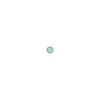

In [132]:
parks.loc[0, 'geometry']

In [133]:
print(parks.loc[0, 'geometry'])

POINT (-86.7619961104642 36.172547470931)


<Axes: >

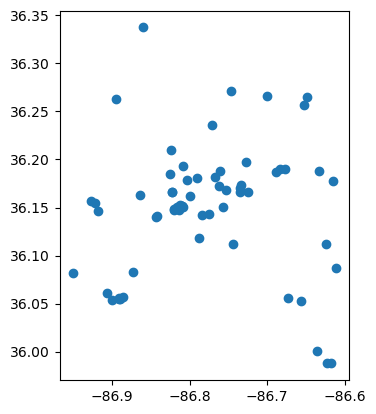

In [134]:
parks.plot()

In [135]:
parks.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 64 entries, 0 to 63
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   GlobalID         64 non-null     object  
 1   FacilityName     64 non-null     object  
 2   FacilityType     64 non-null     object  
 3   NameAbbrev       39 non-null     object  
 4   Address          64 non-null     object  
 5   City             52 non-null     object  
 6   State            64 non-null     object  
 7   ZipCode          54 non-null     object  
 8   PhoneNumber      64 non-null     object  
 9   Email            5 non-null      object  
 10  Website          64 non-null     object  
 11  Description      51 non-null     object  
 12  YearEstablished  38 non-null     float64 
 13  OBJECTID         64 non-null     int64   
 14  geometry         64 non-null     geometry
 15  long             64 non-null     float64 
 16  lat              64 non-null     float

## Reading in BUS STOPS

In [137]:
bus_stops = pd.read_excel('../data/bus_stops.xlsx')

In [138]:
bus_stops.head(1)

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station,stop_timezone,wheelchair_boarding
0,10AHERNN,10AHERNN,10TH AVE N & HERMAN ST NB,10TH AV N & HERMAN ST,36.168831,-86.792339,NaN,NaN,NaN,NaN,NaN,NaN


In [139]:
bus_stops.rename(columns={'stop_lat': 'lat', 'stop_lon': 'long'})

,stop_id,stop_code,stop_name,stop_desc,lat,long,zone_id,stop_url,location_type,parent_station,stop_timezone,wheelchair_boarding
0,10AHERNN,10AHERNN,10TH AVE N & HERMAN ST NB,10TH AV N & HERMAN ST,36.168831,-86.792339,NaN,NaN,NaN,NaN,NaN,NaN
1,12AARCSF,12AARCSF,12TH AVE S & ARCHER ST SB,1037 12TH AVE & ARCHER ST,36.145068,-86.786440,0.0,NaN,NaN,NaN,NaN,0.0
2,12AARCNN,12AARCNN,12TH AVE S & ARCHER ST,1025 12TH AVE & ARCHER ST,36.145223,-86.786227,NaN,NaN,NaN,NaN,NaN,0.0
3,12AACLSN,12AACLSN,12TH AVE S & ACKLEN AVE SB,1905 S 12TH AVE & ACKLEN AVE,36.134037,-86.788948,NaN,NaN,NaN,NaN,NaN,1.0
4,12ADEMNN,12ADEMNN,12TH AVE S & DEMONBREUN ST NB,12TH AV S & DEMONBREUN ST,36.154509,-86.786056,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
1626,51SALANN,51SALANN,51ST AVE N & ALABAMA AVE NB,NaN,36.152941,-86.848543,0.0,NaN,NaN,NaN,NaN,NaN
1627,OLDANDSN,OLDANDSN,OLD HICKORY BLVD & ANDREW JACKSON WAY SB,NaN,36.182233,-86.608443,0.0,NaN,NaN,NaN,NaN,NaN
1628,OLDANDNF,OLDANDNF,OLD HICKORY BLVD & ANDREW JACKSON WAY NB,NaN,36.182644,-86.608426,0.0,NaN,NaN,NaN,NaN,NaN
1629,ANTMIMWF,ANTMIMWF,GLENCLIFF HS,NaN,36.100977,-86.727120,0.0,NaN,NaN,NaN,NaN,NaN


## Reading in LIBRARIES

In [141]:
libraries = gpd.read_file('../data/Library_Facilities_-8873344665390112070.geojson')
print(libraries.crs)
libraries.head( )

EPSG:4326


,FacilityName,GLOBALID,Address,City,ZipCode,PhoneNumber,created_user,created_date,last_edited_user,last_edited_date,...,PublicComputers,Wireless,GroupStudy,CopyMachines,SeedExchange,StudioNPL,Restrooms,BookDrop,Notes,geometry
0,Edgehill,babeb9d5-d990-422a-b9e3-07e258429be0,1409 12th Ave S,Nashville,37203,615-862-5861,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,No,Yes,Yes,No,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.78811 36.13949)
1,Bellevue,1591103c-a036-4beb-a66c-bbb465ce0be3,720 Baugh Rd,Nashville,37221,615-862-5854,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.93666 36.06963)
2,Bordeaux,f3311995-fe56-417b-8804-f56a629eed7a,4000 Clarksville Pike,Nashville,37218,615-862-5856,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.83800 36.21141)
3,East,813281c6-800f-40ef-9513-de1588f90405,206 Gallatin Rd,Nashville,37206,615-862-5860,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,No,Yes,No,Yes,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.75021 36.17896)
4,Edmondson Pike,f2bc8fc4-b502-4255-858e-3269f8a746a2,5501 Edmondson Pike,Nashville,37211,615-880-3957,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,CLOSED for renovation until May 2016\nCall lib...,POINT (-86.74529 36.04495)


In [142]:
# Create longitude and latitude columns
libraries['long'] = libraries.geometry.x
libraries['lat'] = libraries.geometry.y

## Adding the word 'Library' to the end of each FacilityName ('Edgehill' becomes 'Edgehill Library')

In [144]:
libraries['FacilityName'] = libraries['FacilityName'] + ' Library'

In [145]:
libraries

,FacilityName,GLOBALID,Address,City,ZipCode,PhoneNumber,created_user,created_date,last_edited_user,last_edited_date,...,GroupStudy,CopyMachines,SeedExchange,StudioNPL,Restrooms,BookDrop,Notes,geometry,long,lat
0,Edgehill Library,babeb9d5-d990-422a-b9e3-07e258429be0,1409 12th Ave S,Nashville,37203,615-862-5861,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,No,Yes,Yes,No,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.78811 36.13949),-86.788113,36.139490
1,Bellevue Library,1591103c-a036-4beb-a66c-bbb465ce0be3,720 Baugh Rd,Nashville,37221,615-862-5854,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.93666 36.06963),-86.936664,36.069631
2,Bordeaux Library,f3311995-fe56-417b-8804-f56a629eed7a,4000 Clarksville Pike,Nashville,37218,615-862-5856,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.83800 36.21141),-86.838003,36.211405
3,East Library,813281c6-800f-40ef-9513-de1588f90405,206 Gallatin Rd,Nashville,37206,615-862-5860,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,No,Yes,No,Yes,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.75021 36.17896),-86.750207,36.178958
4,Edmondson Pike Library,f2bc8fc4-b502-4255-858e-3269f8a746a2,5501 Edmondson Pike,Nashville,37211,615-880-3957,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,No,Yes,Yes,CLOSED for renovation until May 2016\nCall lib...,POINT (-86.74529 36.04495),-86.745288,36.044955
5,Goodlettsville Library,f0207a00-5027-4424-85ab-280182125acf,205 Rivergate Pkwy,Goodlettsville,37072,615-862-5862,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,No,Yes,Yes,Closed on Friday and Sunday. Call library to c...,POINT (-86.71077 36.31467),-86.710766,36.314667
6,Green Hills Library,33b5a870-57e3-4f3d-b7e1-f57c381b3740,3701 Benham Ave,Nashville,37215,615-862-5863,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,Yes,Yes,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.80917 36.10979),-86.809165,36.109785
7,Hadley Park Library,dbada64b-8dfe-44cc-8ee3-66ad158ed299,1039 28th Ave N,Nashville,37208,615-862-5865,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,No,Yes,No,No,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.82084 36.16682),-86.820837,36.166815
8,Hermitage Library,7220456e-148f-4be0-8493-aa67e28bf259,3700 James Kay Ln,Hermitage,37076,615-880-3951,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,Yes,Yes,No,No,Yes,Yes,Call library to confirm hours on holidays and ...,POINT (-86.61508 36.17757),-86.615082,36.177569
9,Inglewood Library,3d2a0dfb-ad5c-4ed6-90bb-de36348ed3a3,4312 Gallatin Road,Nashville,37216,615-862-5866,CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",CollaborationAdminNashville,"Mon, 16 Dec 2024 19:26:53 GMT",...,No,Yes,Yes,No,Yes,Yes,Closed on Friday and Sunday. Call library to ...,POINT (-86.72499 36.22584),-86.724993,36.225839


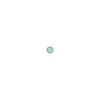

In [146]:
libraries.loc[0, 'geometry']

<Axes: >

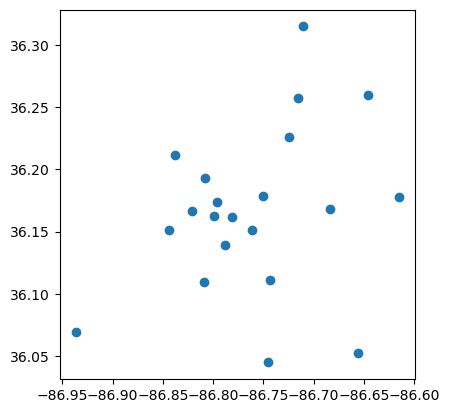

In [147]:
libraries.plot()

## Nashville Map

In [149]:
nash_map = folium.Map(location = [36.1627, -86.7816], zoom_start=12, tiles="cartodb positron")

nash_map

## reading in updated DF that has addresses

In [151]:
address_df = pd.read_excel('../data/schools_with_locations.xlsx')

In [152]:
address_df.shape

(118, 50)

In [153]:
address_df['zip'].value_counts()

zip
37013    15
37211    11
37209     8
37206     7
37214     7
37207     7
37203     6
37115     6
37216     5
37076     5
37210     5
37208     5
37217     4
37072     3
37221     3
37215     3
37205     3
37204     3
37138     3
37218     2
37189     2
37220     2
37027     1
37080     1
37212     1
Name: count, dtype: int64

In [154]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

## mapping everything together

In [156]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')
print(zipcodes.crs)
zipcodes.head( )

EPSG:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


<Axes: >

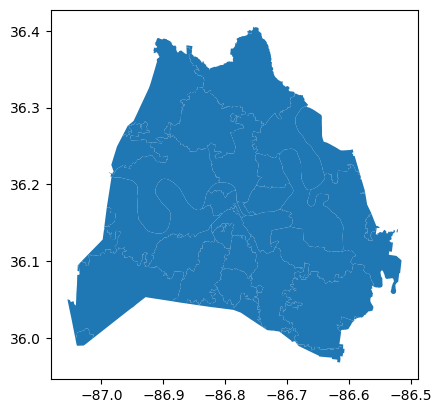

In [157]:
zipcodes.plot()

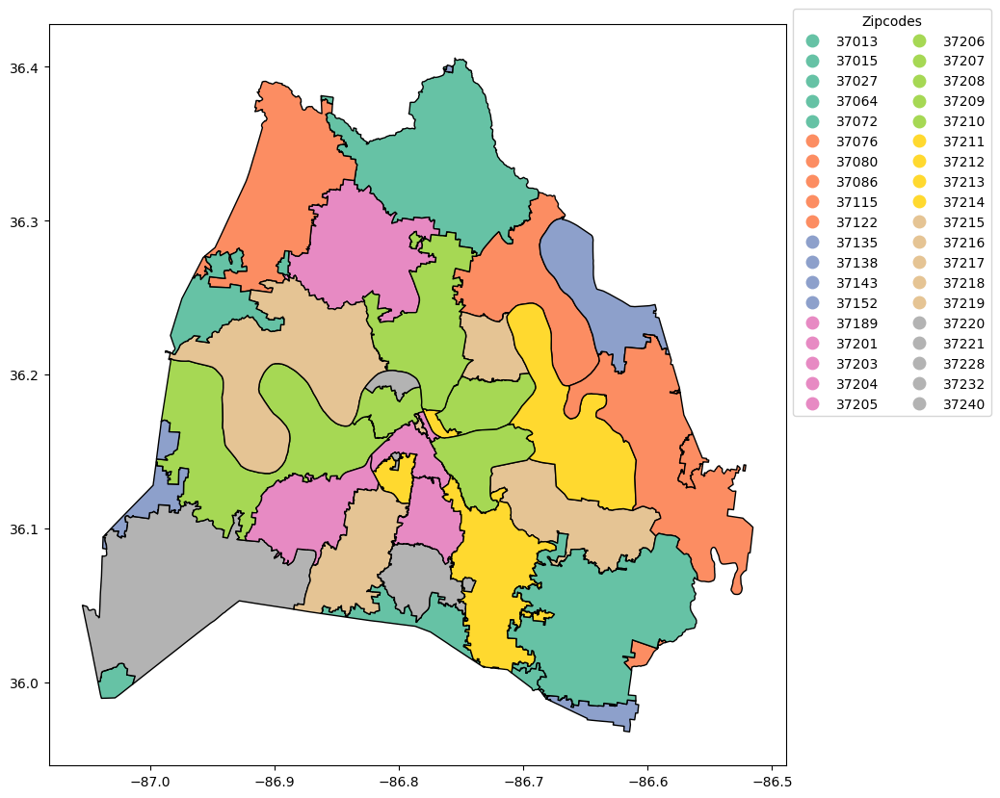

In [158]:
##probably won't use, just want to have for reference

leg_kwds = {'title': 'Zipcodes', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}

zipcodes.plot(column = 'zip', figsize=(10, 10),
              edgecolor = 'black',
              legend = True, legend_kwds = leg_kwds, 
              cmap = 'Set2')
plt.show()

In [159]:
zipcodes.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [160]:
schools_geo = gpd.GeoDataFrame(address_df, 
                               crs=zipcodes.crs, 
                               geometry = gpd.points_from_xy(address_df.long, address_df.lat))

In [161]:
type(schools_geo)

geopandas.geodataframe.GeoDataFrame

In [162]:
zipcodes = zipcodes[['zip', 'po_name', 'geometry']]

In [163]:
schools_by_zip = gpd.sjoin(schools_geo, zipcodes, predicate = 'intersects')

In [164]:
schools_by_zip.columns

Index(['school_number', 'school_name', 'wida_student_group', 'wida_exit_denom',
       'wida_n_exit', 'wida_pct_exit', 'wida_growth_standard_denom',
       'wida_n_met_growth_standard', 'wida_pct_met_growth_standard',
       'wida_literacy_avg', 'wida_comp_avg', 'tvaas_overall_comp',
       'tvaas_lit_comp', 'tvaas_num_comp', 'tvaas_litandnum_comp',
       'tvaas_sci_comp', 'tvaas_ss_comp', 'merge_step1', 'letter_grade',
       'merge_step2', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'num_scoring_21orhigher', 'pct_scoring_21orhigher',
       'num_scoring_below19', 'pct_scoring_below19', 'merge_step3',
       'hs_grad_cohort_state', 'hs_grad_count_state', 'hs_grad_rate_state',
       'hs_grad_cohort_federal', 'hs_grad_count_federal',
       'hs_grad_rate_federal', 'merge_step4', 'school_type', 'short_address',
       'city', 'zip_left', 'metro_dist', 'schbrd_dist', 'schbrd_mbr', 'long',
       'lat',

In [165]:
schools_by_zip['zip_left'].value_counts()

zip_left
37013    15
37211    11
37209     8
37206     7
37214     7
37207     7
37203     6
37115     6
37216     5
37076     5
37210     5
37208     5
37217     4
37072     3
37221     3
37215     3
37205     3
37204     3
37138     3
37218     2
37189     2
37220     2
37027     1
37080     1
37212     1
Name: count, dtype: int64

In [166]:
schools_by_zip['zip_right'].value_counts()

zip_right
37013    15
37211    11
37207     8
37209     8
37206     7
37214     7
37203     6
37216     5
37076     5
37210     5
37208     5
37115     5
37217     4
37072     3
37221     3
37215     3
37205     3
37204     3
37138     3
37218     2
37189     2
37220     2
37027     1
37080     1
37212     1
Name: count, dtype: int64

In [167]:
print("Total schools:", len(schools_geo))
print("Schools matched to zip:", len(schools_by_zip))
print("Unmatched schools:", len(schools_geo) - len(schools_by_zip))


Total schools: 118
Schools matched to zip: 118
Unmatched schools: 0


In [168]:
matched_index = schools_by_zip.index
unmatched_schools = schools_geo[~schools_geo.index.isin(matched_index)]

print("Unmatched schools:")
print(unmatched_schools)


Unmatched schools:
Empty GeoDataFrame
Columns: [school_number, school_name, wida_student_group, wida_exit_denom, wida_n_exit, wida_pct_exit, wida_growth_standard_denom, wida_n_met_growth_standard, wida_pct_met_growth_standard, wida_literacy_avg, wida_comp_avg, tvaas_overall_comp, tvaas_lit_comp, tvaas_num_comp, tvaas_litandnum_comp, tvaas_sci_comp, tvaas_ss_comp, merge_step1, letter_grade, merge_step2, act_validtests, act_part_rate, act_avg_eng, act_avg_math, act_avg_reading, act_avg_sci, act_avg_comp, num_scoring_21orhigher, pct_scoring_21orhigher, num_scoring_below19, pct_scoring_below19, merge_step3, hs_grad_cohort_state, hs_grad_count_state, hs_grad_rate_state, hs_grad_cohort_federal, hs_grad_count_federal, hs_grad_rate_federal, merge_step4, school_type, short_address, city, zip, metro_dist, schbrd_dist, schbrd_mbr, long, lat, cluster_geo, cluster_name, geometry]
Index: []

[0 rows x 51 columns]


In [169]:
print(schools_geo.crs)
print(zipcodes.crs)

EPSG:4326
EPSG:4326


In [170]:
# Check for duplicates in index of schools_geo after join
schools_by_zip.index.value_counts().value_counts()

count
1    118
Name: count, dtype: int64

In [171]:
schools_by_zip = gpd.sjoin(schools_geo, zipcodes, predicate='within')
schools_by_zip = schools_by_zip[~schools_by_zip.index.duplicated(keep='first')]

In [172]:
schools_by_zip['zip_right'].value_counts()

zip_right
37013    15
37211    11
37207     8
37209     8
37206     7
37214     7
37203     6
37216     5
37076     5
37210     5
37208     5
37115     5
37217     4
37072     3
37221     3
37215     3
37205     3
37204     3
37138     3
37218     2
37189     2
37220     2
37027     1
37080     1
37212     1
Name: count, dtype: int64

In [173]:
schools_by_zip.groupby('zip_right')['school_number'].nunique()

zip_right
37013    15
37027     1
37072     3
37076     5
37080     1
37115     5
37138     3
37189     2
37203     6
37204     3
37205     3
37206     7
37207     8
37208     5
37209     8
37210     4
37211    11
37212     1
37214     7
37215     3
37216     5
37217     4
37218     2
37220     2
37221     3
Name: school_number, dtype: int64

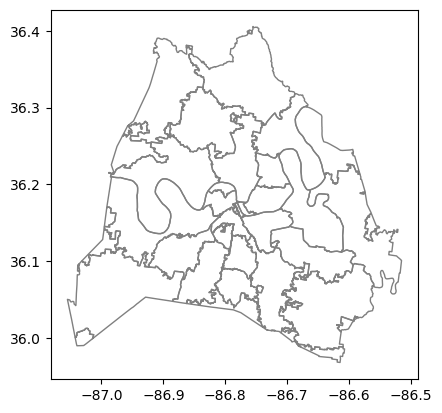

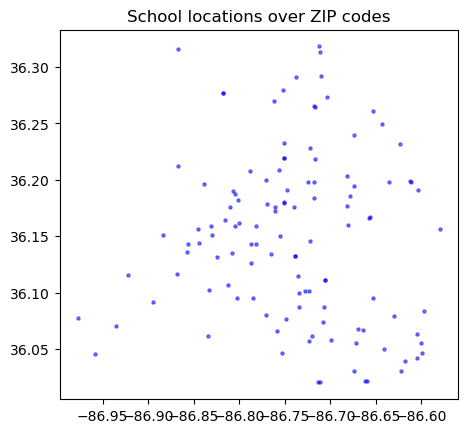

In [174]:
zipcodes.plot(edgecolor='gray', facecolor='none')
schools_geo.plot(color='blue', markersize=5, alpha=0.5)
plt.title("School locations over ZIP codes")
plt.show()

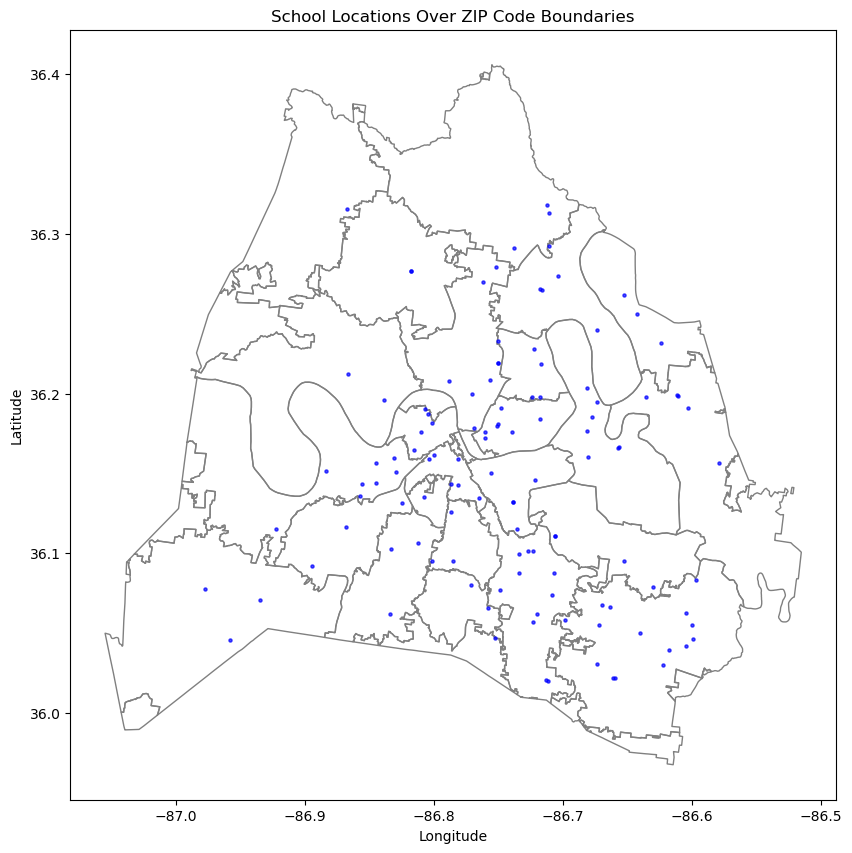

In [175]:
import matplotlib.pyplot as plt

# Create a single plot and get the axes object
fig, ax = plt.subplots(figsize=(10, 10))  # Adjust size if needed

# Plot zipcodes first (background)
zipcodes.plot(ax=ax, edgecolor='gray', facecolor='none')

# Plot schools on the same axes
schools_geo.plot(ax=ax, color='blue', markersize=5, alpha=0.7)

# Add title and show
plt.title("School Locations Over ZIP Code Boundaries")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

## When shown visually, some school locations don't line up perfectly with the python zipcode boundaries. This shows where the school locations are. 

## Trying to create a 1 mile radius around each school -- to later see if there are any libraries or parks within that radius

In [178]:
##need to change CRS because right now it's in DEGREES, but I need to change to distance (meters) to create a radius

schools_geo_updated_espg = schools_geo.to_crs(epsg=3857)  # Web Mercator (units in meters)

In [179]:
mile_buffer = schools_geo_updated_espg.buffer(1609.34)  # 1 mile in meters
schools_geo_updated_espg['buffer_1mile'] = mile_buffer

In [180]:
buffer_1mile_from_school = schools_geo_updated_espg.copy()
buffer_1mile_from_school.set_geometry('buffer_1mile', inplace=True)

In [181]:
# buffer_1mile_from_school = buffer_1mile_from_school.to_crs(epsg=4326)

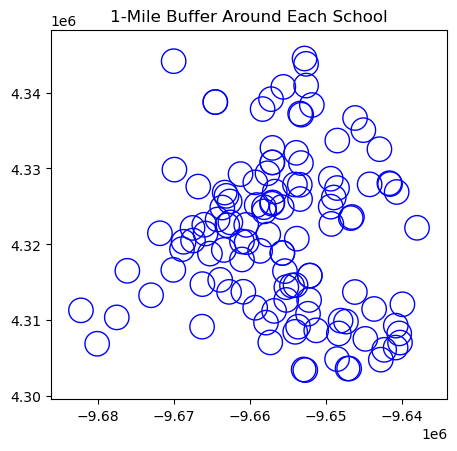

In [182]:
buffer_1mile_from_school.plot(edgecolor='blue', facecolor='none')
plt.title("1-Mile Buffer Around Each School")
plt.show()

In [183]:
gpd.overlay(buffer_1mile_from_school, schools_geo_updated_espg, how='intersection')

,school_number_1,school_name_1,wida_student_group_1,wida_exit_denom_1,wida_n_exit_1,wida_pct_exit_1,wida_growth_standard_denom_1,wida_n_met_growth_standard_1,wida_pct_met_growth_standard_1,wida_literacy_avg_1,...,city_2,zip_2,metro_dist_2,schbrd_dist_2,schbrd_mbr_2,long_2,lat_2,cluster_geo_2,cluster_name_2,buffer_1mile


In [184]:
print(buffer_1mile_from_school.crs)
print(schools_geo_updated_espg.crs)


EPSG:3857
EPSG:3857


In [185]:
print(buffer_1mile_from_school.geom_type.unique())
print(schools_geo_updated_espg.geom_type.unique())

['Polygon']
['Point']


In [186]:
# Join: Which schools (points) fall inside which 1-mile buffer polygon?
schools_in_buffer = gpd.sjoin(schools_geo_updated_espg, buffer_1mile_from_school, predicate='within')

print(schools_in_buffer)

     school_number_left              school_name_left wida_student_group_left  \
0                     1       A. Z. Kelley Elementary            All Students   
0                     1       A. Z. Kelley Elementary            All Students   
1                     5         Alex Green Elementary            All Students   
1                     5         Alex Green Elementary            All Students   
2                    10              Amqui Elementary            All Students   
..                  ...                           ...                     ...   
115                 555               Pearl-Cohn High            All Students   
116                 620  Stratford STEM Magnet School            All Students   
116                 620  Stratford STEM Magnet School            All Students   
117                 704             Whites Creek High            All Students   
117                 704             Whites Creek High            All Students   

     wida_exit_denom_left w

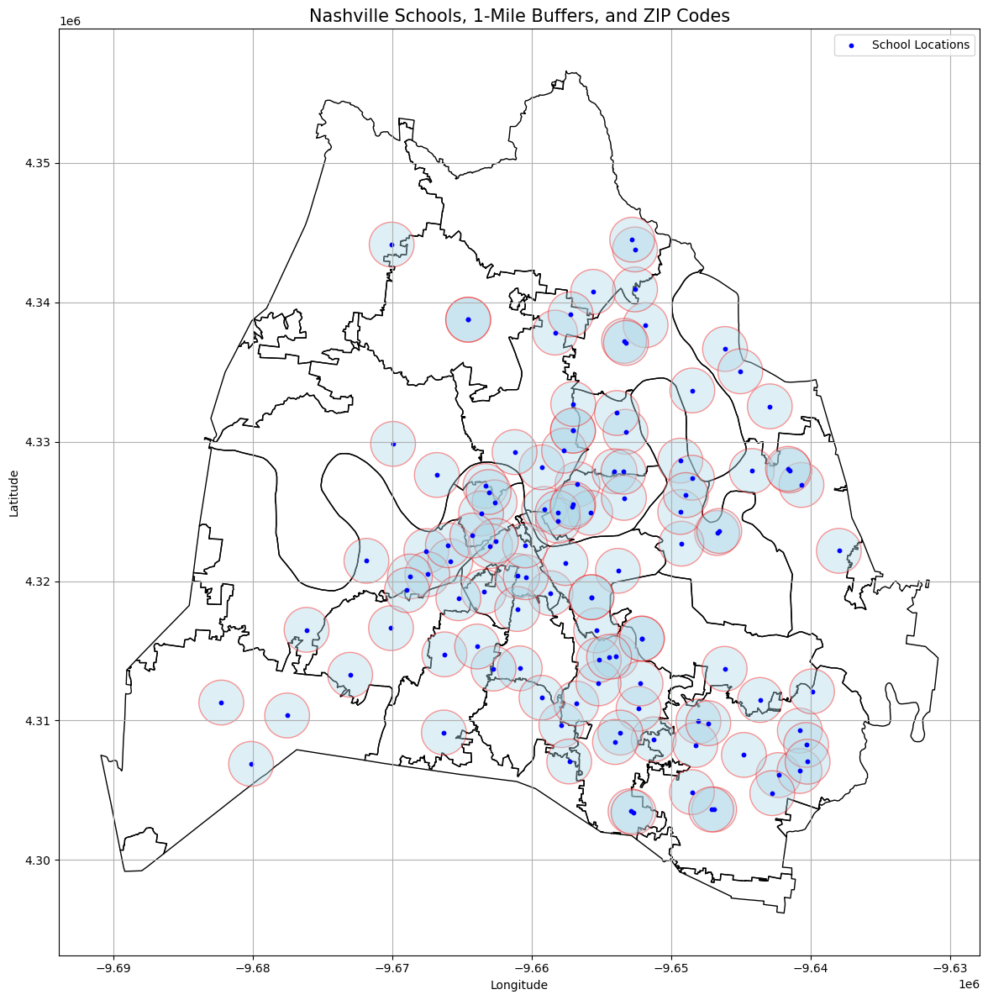

In [187]:
import matplotlib.pyplot as plt

# OPTIONAL: make sure all are same CRS 
zipcodes_proj = zipcodes.to_crs(epsg=3857)
schools_proj = schools_geo.to_crs(epsg=3857)
buffers_proj = buffer_1mile_from_school.to_crs(epsg=3857)

# Create the figure and axis
fig, ax = plt.subplots(figsize=(12, 12))

# Plot ZIP code boundaries (base layer)
zipcodes_proj.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1, label='ZIP Code Boundaries')

# Plot the 1-mile buffer areas
buffers_proj.plot(ax=ax, facecolor='lightblue', edgecolor='red', alpha=0.4, label='1-Mile Radius')

# Plot school locations
schools_proj.plot(ax=ax, color='blue', markersize=10, label='School Locations')

# Customize and display
plt.title("Nashville Schools, 1-Mile Buffers, and ZIP Codes", fontsize=15)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## adding BUS STOPS to the map

In [189]:
bus_stops.rename(columns=lambda x: x.strip().lower(), inplace=True)

In [190]:
bus_stops.columns

Index(['stop_id', 'stop_code', 'stop_name', 'stop_desc', 'stop_lat',
       'stop_lon', 'zone_id', 'stop_url', 'location_type', 'parent_station',
       'stop_timezone', 'wheelchair_boarding'],
      dtype='object')

In [191]:
from shapely.geometry import Point

geometry = [Point(xy) for xy in zip(bus_stops['stop_lon'], bus_stops['stop_lat'])]

bus_geo = gpd.GeoDataFrame(bus_stops, geometry=geometry, crs='EPSG:4326')

In [192]:
bus_plot = bus_geo.to_crs(epsg=3857)

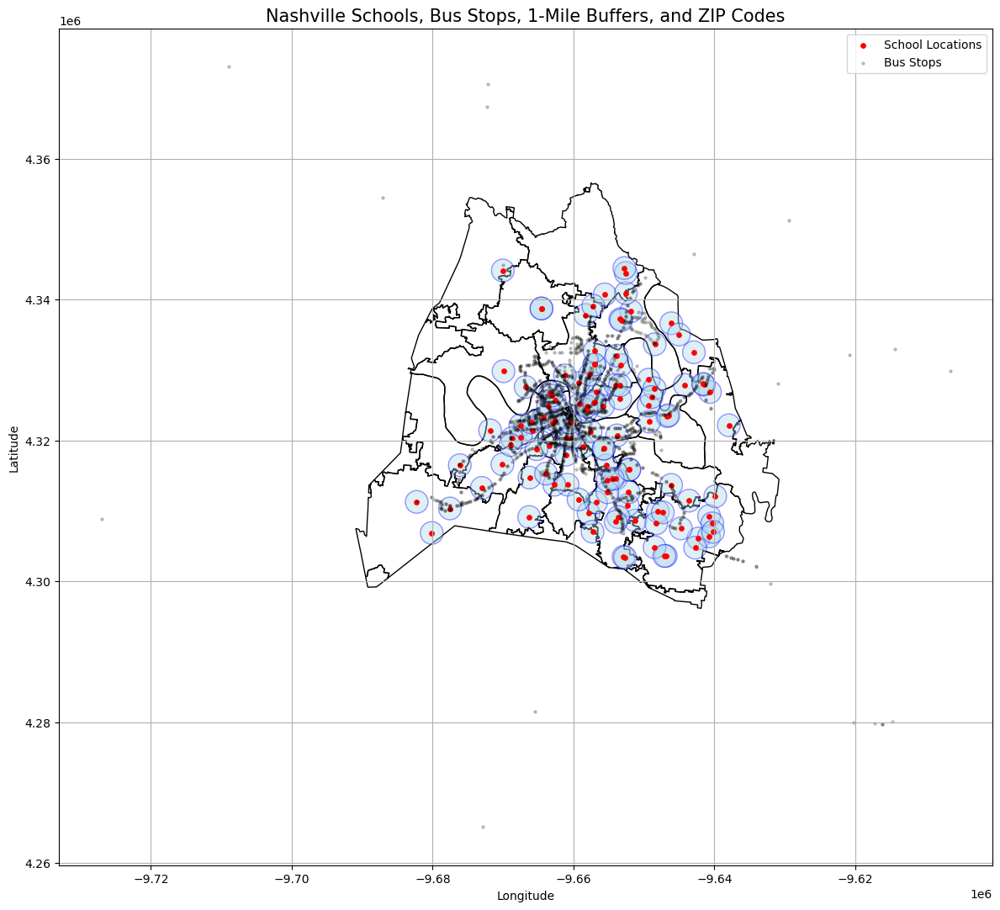

In [193]:
# Plot 
fig, ax = plt.subplots(figsize=(12, 12))

# ZIP codes
zipcodes_proj.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1, label='ZIP Code Boundaries')

# 1 mile buffer around schools
buffers_proj.plot(ax=ax, facecolor='lightblue', edgecolor='blue', alpha=0.4, label='1-Mile Radius')

# Schools points
schools_proj.plot(ax=ax, color='red', markersize=15, label='School Locations')

# Bus stops points
bus_plot.plot(ax=ax, color='black', markersize=5, alpha=0.2, edgecolor='black', label='Bus Stops')

# Title, labels, colors, etc
plt.title("Nashville Schools, Bus Stops, 1-Mile Buffers, and ZIP Codes", fontsize=15)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## adding PARKS to the map

In [195]:
parks_plot = parks.to_crs(epsg=3857)

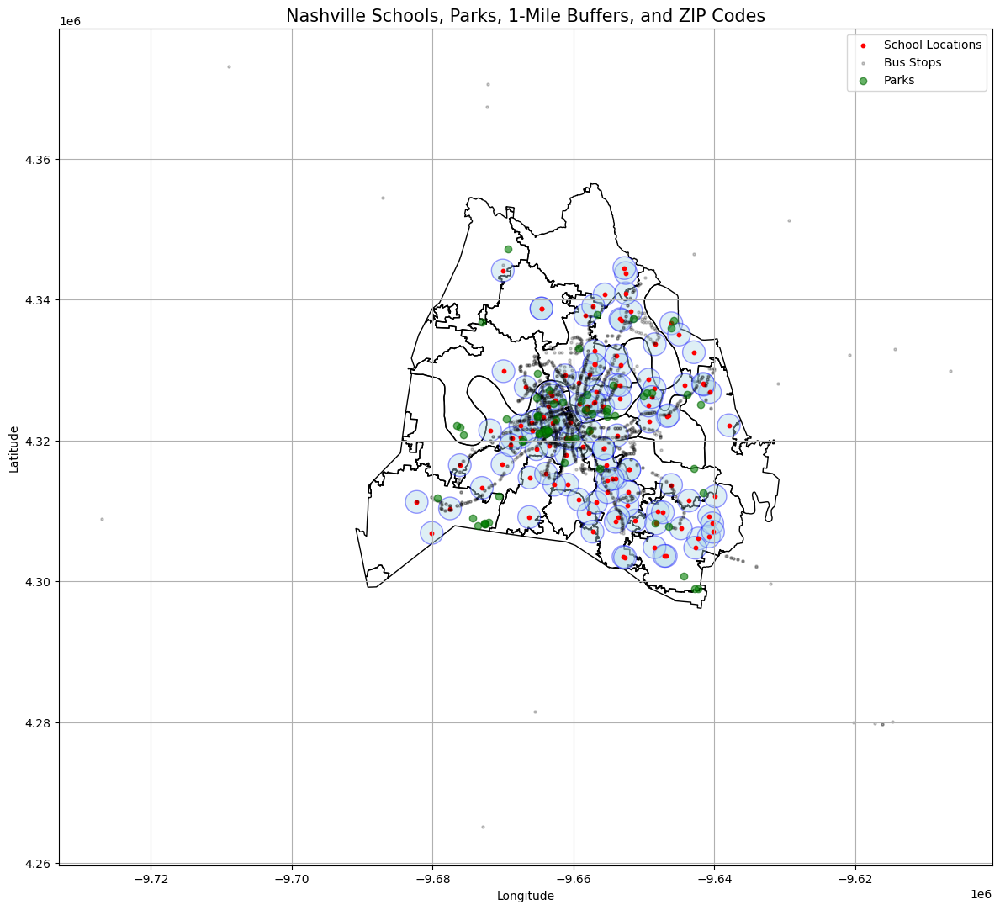

In [196]:
# Plot 
fig, ax = plt.subplots(figsize=(12, 12))

# ZIP codes
zipcodes_proj.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1, label='ZIP Code Boundaries')

# 1 mile buffer around schools
buffers_proj.plot(ax=ax, facecolor='lightblue', edgecolor='blue', alpha=0.4, label='1-Mile Radius')

# Schools points
schools_proj.plot(ax=ax, color='red', markersize=10, label='School Locations')

# Bus stops points
bus_plot.plot(ax=ax, color='black', markersize=5, alpha=0.2, edgecolor='black', label='Bus Stops')

# Parks points
parks_plot.plot(ax=ax, color='green', alpha=0.6, edgecolor='darkgreen', label='Parks')

# Title, labels, colors, etc
plt.title("Nashville Schools, Parks, 1-Mile Buffers, and ZIP Codes", fontsize=15)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## adding LIBRARIES to the map

In [198]:
libs_plot = libraries.to_crs(epsg=3857)

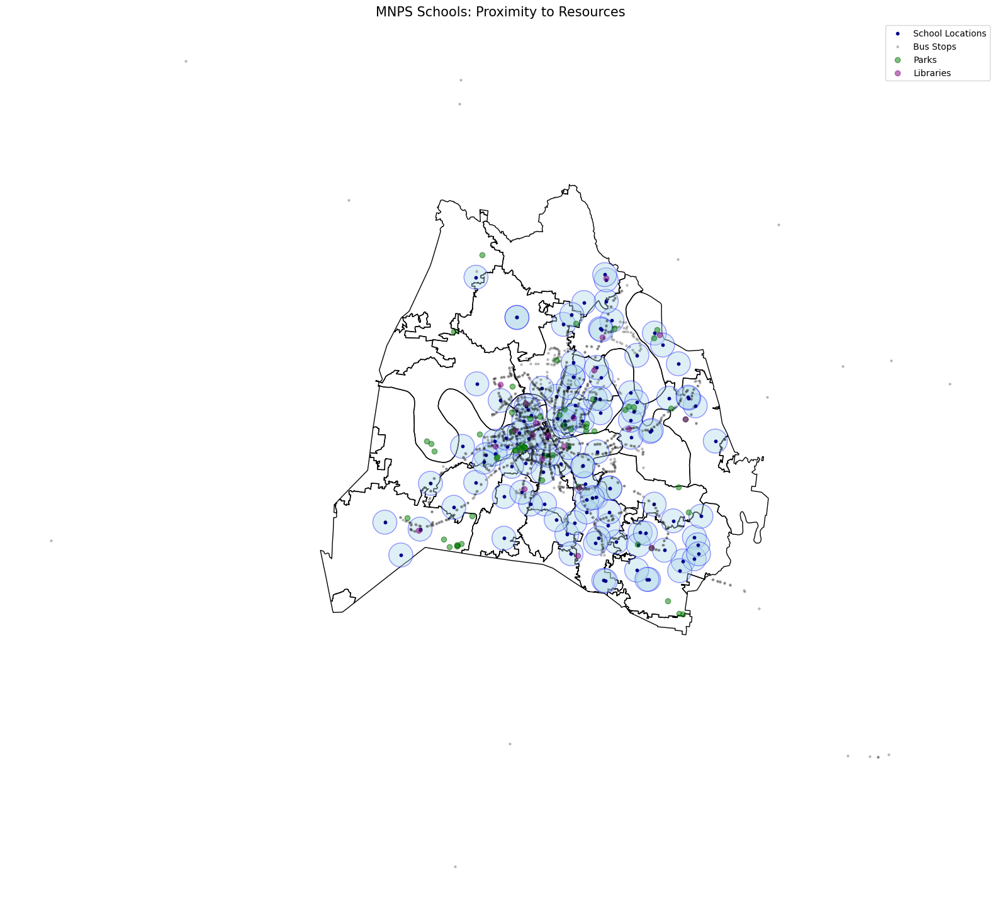

In [199]:
# Plot 
fig, ax = plt.subplots(figsize=(16, 16))

# ZIP codes
zipcodes_proj.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1, label='ZIP Code Boundaries')

# 1 mile buffer around schools
buffers_proj.plot(ax=ax, facecolor='lightblue', edgecolor='blue', alpha=0.4, label='1-Mile Radius')

# Schools points
schools_proj.plot(ax=ax, color='darkblue', markersize=10, label='School Locations')

# Bus stops points
bus_plot.plot(ax=ax, color='black', markersize=5, alpha=0.2, edgecolor='black', label='Bus Stops')

# Parks points
parks_plot.plot(ax=ax, color='green', alpha=0.5, edgecolor='darkgreen', label='Parks')

# Libraries points
libs_plot.plot(ax=ax, color='purple', alpha=0.5, edgecolor='purple', label='Libraries')

ax.axis('off')

# Title, labels, colors, etc
plt.title("MNPS Schools: Proximity to Resources", fontsize=15)
#plt.xlabel("Longitude")
#plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## Using FOLIUM

In [201]:
##adding zipcode lines

folium.GeoJson(
    zipcodes,
    name='ZIP Code Boundaries',
    style_function=lambda feature: {
        'fillColor': 'transparent',
        'color': 'black',
        'weight': .2
    }
).add_to(nash_map)

In [202]:
##adding school locations
#for idx, row in address_df.iterrows():
   # folium.Marker(
    #    location=[row['lat'], row['long']],
        #popup=row['school_name'],
  #  ).add_to(nash_map)

#nash_map

In [203]:
print(buffers_proj.geom_type.value_counts())

Polygon    118
Name: count, dtype: int64


In [204]:
#zipcodes_new = zipcodes.to_crs(epsg=4326)
schools_new = schools_geo.to_crs(epsg=4326)
buffers_new = buffer_1mile_from_school.buffer(1609.34) #convert 1 mile to meters
libraries_new=libraries.to_crs(epsg=4326)
parks_new=parks.to_crs(epsg=4326)
bus_new=bus_geo.to_crs(epsg=4326)

In [205]:
#folium.GeoJson(
   # zipcodes_new,
    #name='ZIP Code Boundaries',
    #style_function=lambda feature: {
        #'fillColor': 'transparent',
        #'color': 'black',
        #'weight': 1,
   # }
#).add_to(nash_map)

In [206]:
#for _, row in schools_new.iterrows():
   # folium.CircleMarker(
   # location=[row.geometry.y, row.geometry.x],
   # radius=5,
   # color='red',
   # fill=True,
   # fill_color='red',
    #fill_opacity=0.8,
    #popup=folium.Popup(str(row['school_name']), max_width=100),
    #tooltip=row['school_name']
#).add_to(nash_map)

In [207]:
libraries.geom_type.unique()

array(['Point'], dtype=object)

In [208]:
parks.geom_type.unique()

array(['Point'], dtype=object)

In [209]:
bus_geo.geom_type.unique()

array(['Point'], dtype=object)

In [210]:
#for _, row in schools_new.iterrows():
   # popup_html = f"""
   # <div style="font-size:12px; max-width:120px;">
   #     {row['school_name']}
   # </div>
   # """
    #folium.CircleMarker(
      #  location=[row.geometry.y, row.geometry.x],
      #  radius=5,
      #  color='blue',
       # fill=True,
       # fill_color='blue',
        #fill_opacity=1.0,
        #opacity= 1.0,
       # popup=folium.Popup(popup_html, max_width=120),  #popup size
        #tooltip=row['school_name']  # popup label
    #).add_to(nash_map)


In [211]:
schools_new.columns

Index(['school_number', 'school_name', 'wida_student_group', 'wida_exit_denom',
       'wida_n_exit', 'wida_pct_exit', 'wida_growth_standard_denom',
       'wida_n_met_growth_standard', 'wida_pct_met_growth_standard',
       'wida_literacy_avg', 'wida_comp_avg', 'tvaas_overall_comp',
       'tvaas_lit_comp', 'tvaas_num_comp', 'tvaas_litandnum_comp',
       'tvaas_sci_comp', 'tvaas_ss_comp', 'merge_step1', 'letter_grade',
       'merge_step2', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'num_scoring_21orhigher', 'pct_scoring_21orhigher',
       'num_scoring_below19', 'pct_scoring_below19', 'merge_step3',
       'hs_grad_cohort_state', 'hs_grad_count_state', 'hs_grad_rate_state',
       'hs_grad_cohort_federal', 'hs_grad_count_federal',
       'hs_grad_rate_federal', 'merge_step4', 'school_type', 'short_address',
       'city', 'zip', 'metro_dist', 'schbrd_dist', 'schbrd_mbr', 'long', 'lat',
       'clu

In [212]:
for _, row in schools_new.iterrows():
    #popup_html = f"""
    #<div style="font-size:12px; max-width:120px;">
        #{row['school_name']}
   # </div>
    #"""

    # school icon file path
    school_icon = folium.features.CustomIcon('../visuals/school.png', icon_size=(20, 20))

    # Create and add the marker with popup and tooltip
    folium.Marker(
        location=[row['lat'], row['long']],  # Folium needs [lat, lon]
        icon=school_icon,
        tooltip=row['school_name']
    ).add_to(nash_map)



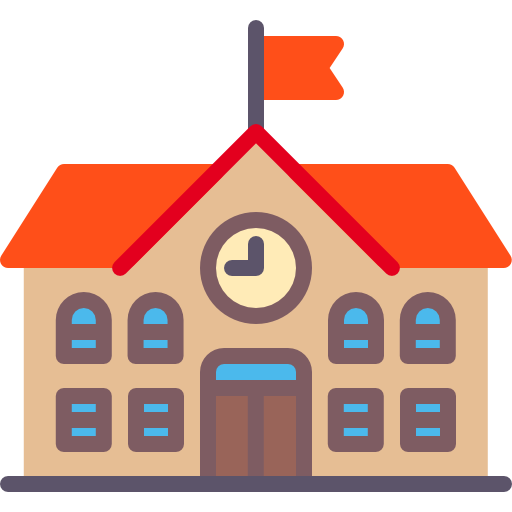
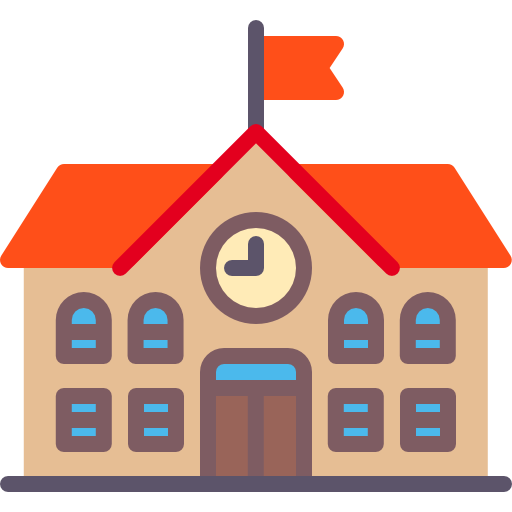
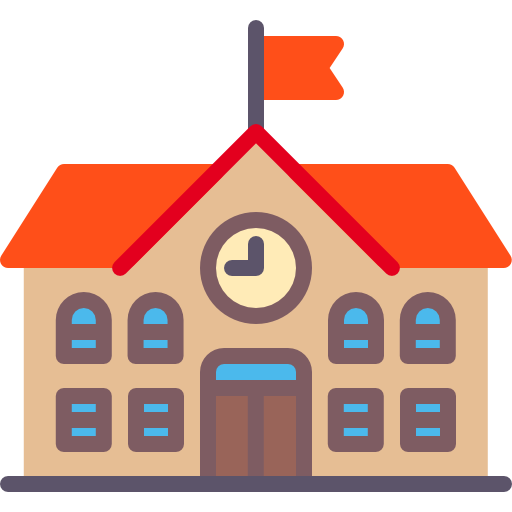
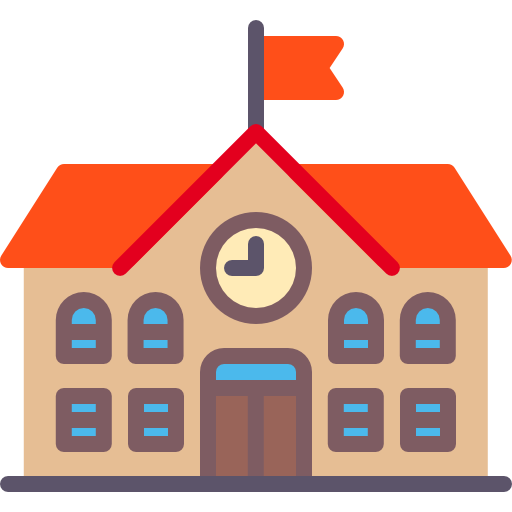
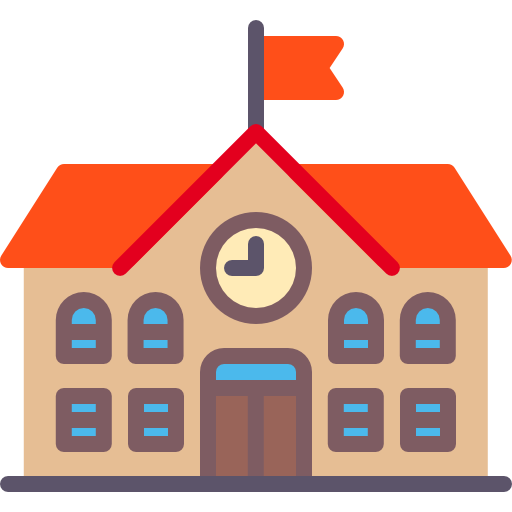
...
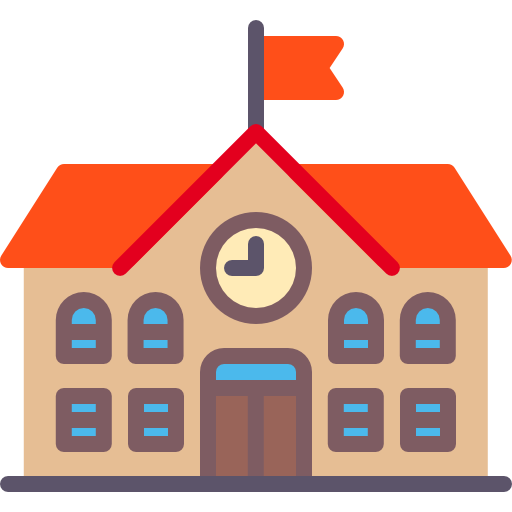
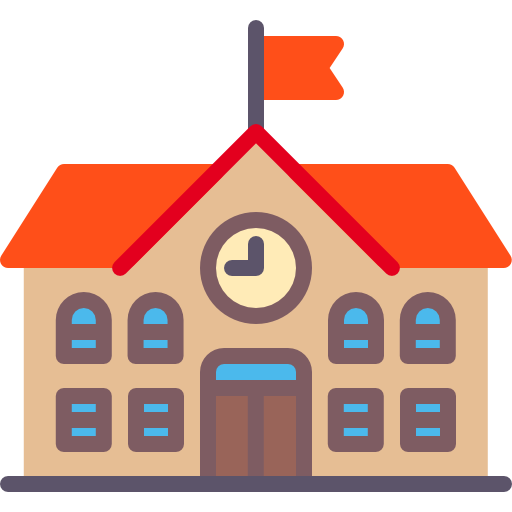
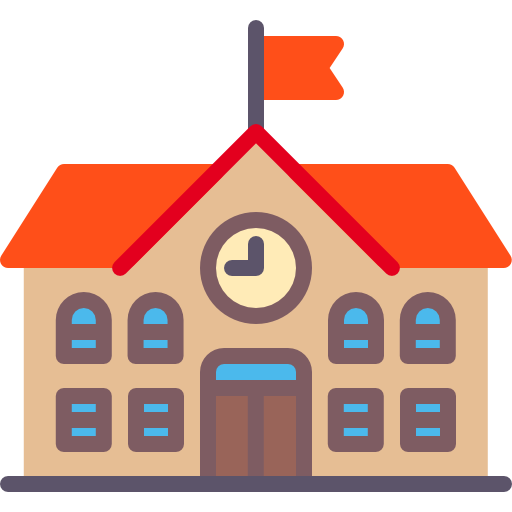
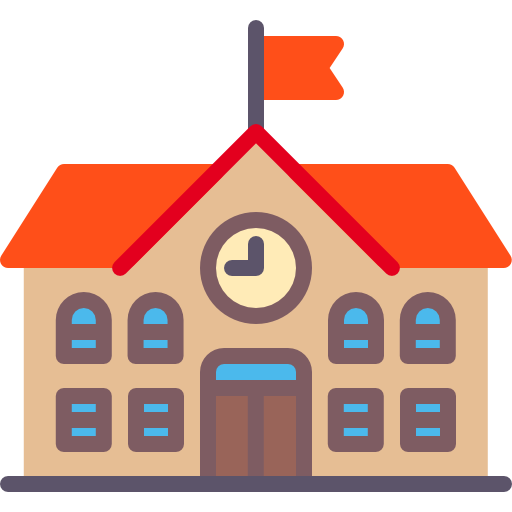
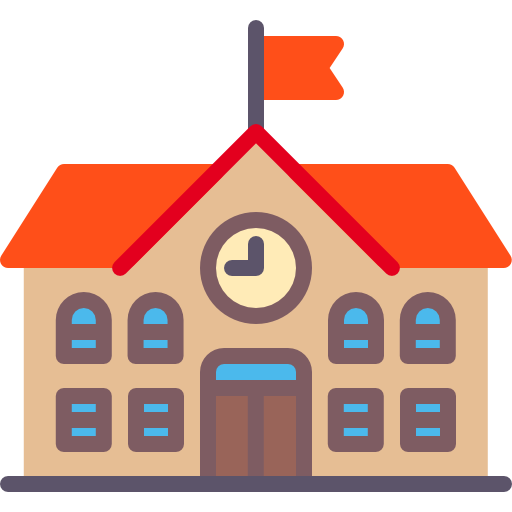

In [213]:
nash_map

In [214]:
for _, row in parks_new.iterrows():
    #popup_html = f"""
    #<div style="font-size:12px; max-width:120px;">
        #{row['FacilityName']}
   # </div>
    #"""

    # parks icon file path
    park_icon = folium.features.CustomIcon('../visuals/green trees.png', icon_size=(20, 20))

    # Create and add the marker with popup and tooltip
    folium.Marker(
        location=[row['lat'], row['long']],  # Folium needs [lat, lon]
        icon=park_icon,
        tooltip=row['FacilityName']
    ).add_to(nash_map)


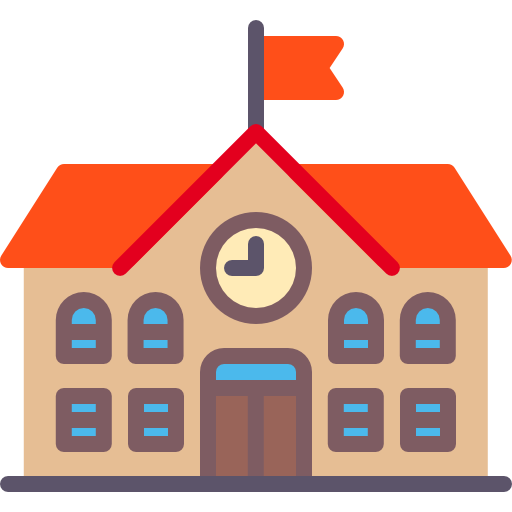
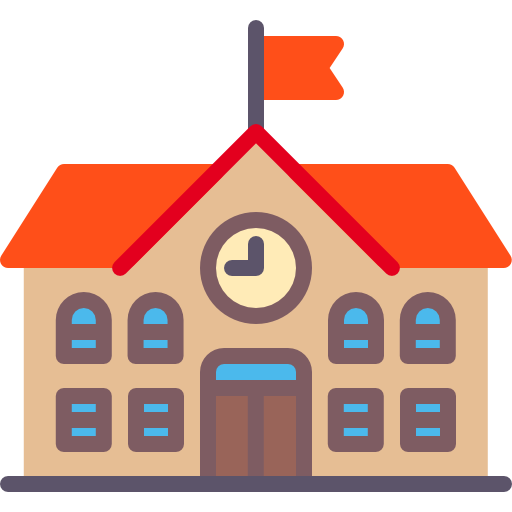
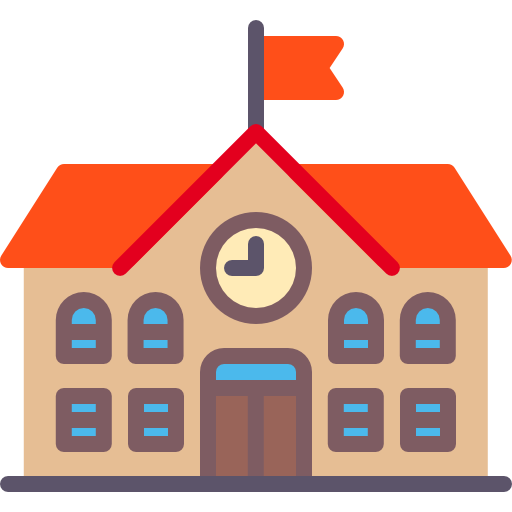
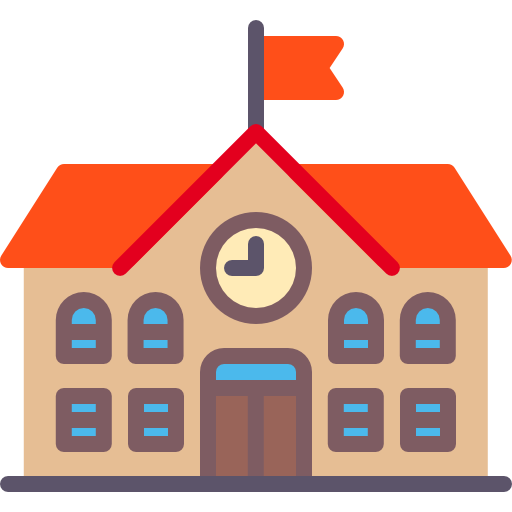
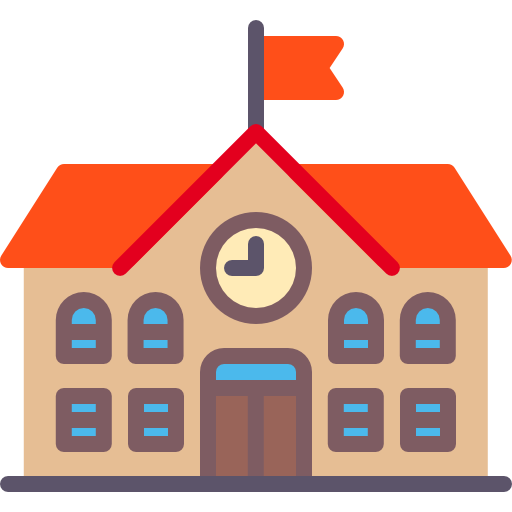
...
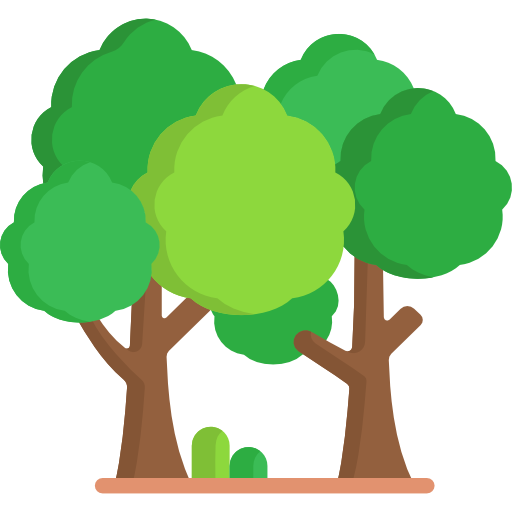
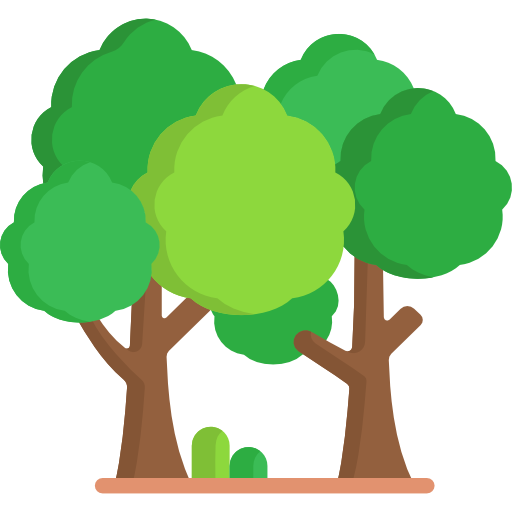
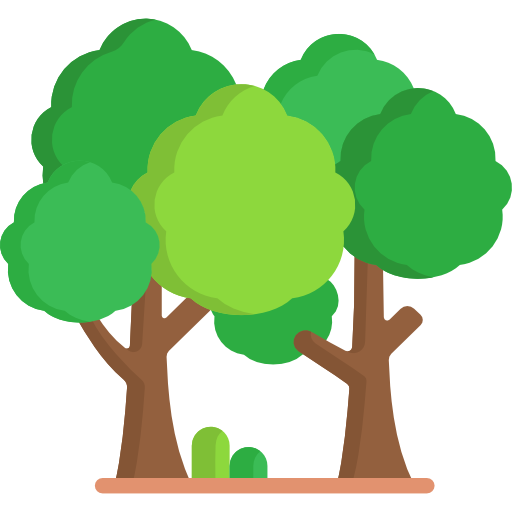
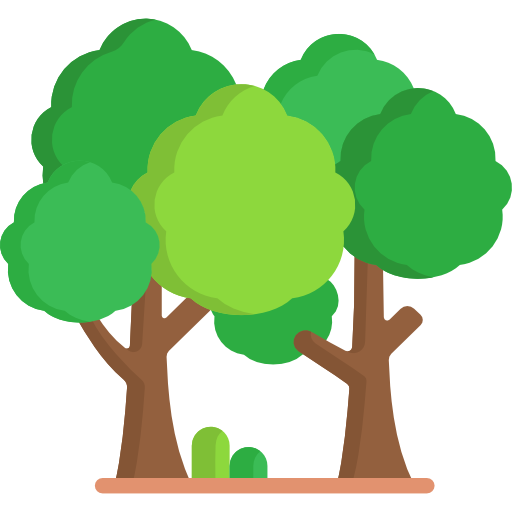
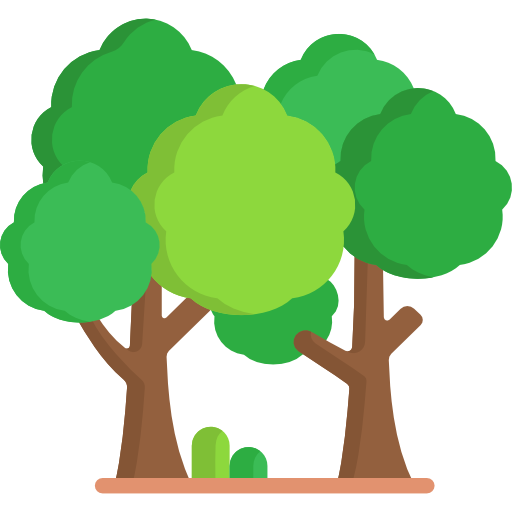

In [215]:
nash_map

In [216]:
for _, row in libraries_new.iterrows():
    #popup_html = f"""
    #<div style="font-size:12px; max-width:120px;">
        #{row['FacilityName']}
   # </div>
    #"""

    # libraries icon file path
    lib_icon = folium.features.CustomIcon('../visuals/books.png', icon_size=(20, 20))

    # Create and add the marker with popup and tooltip
    folium.Marker(
        location=[row['lat'], row['long']],  # Folium needs [lat, lon]
        icon=lib_icon,
        tooltip=row['FacilityName']
    ).add_to(nash_map)


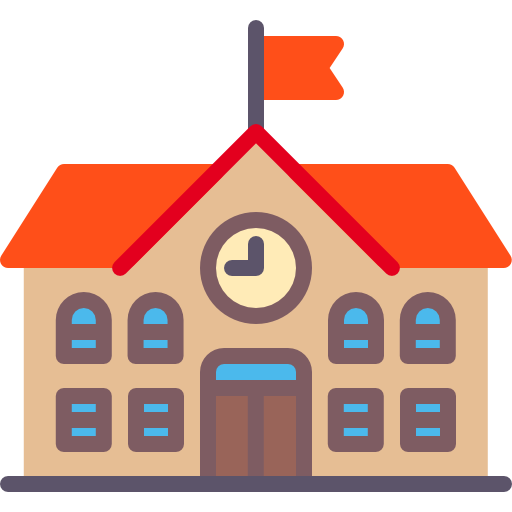
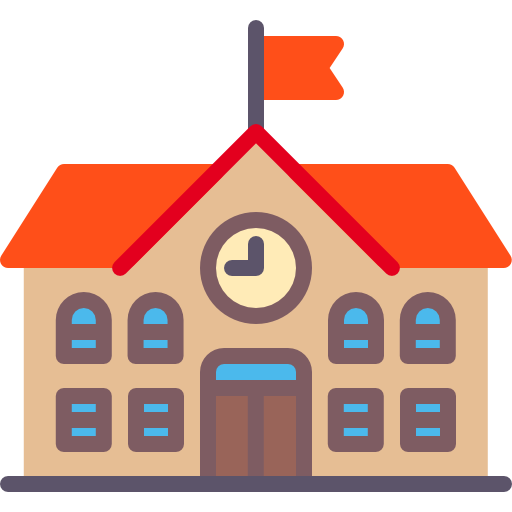
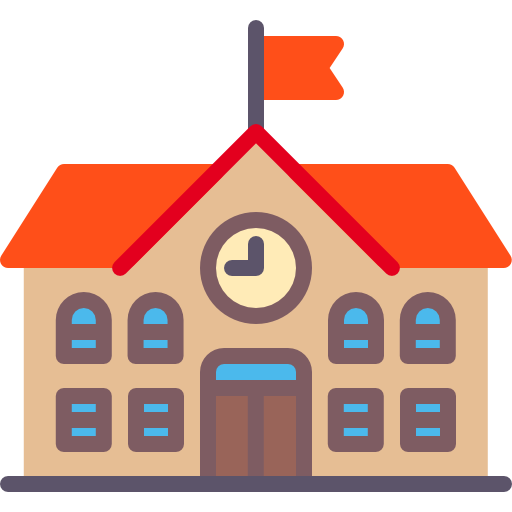
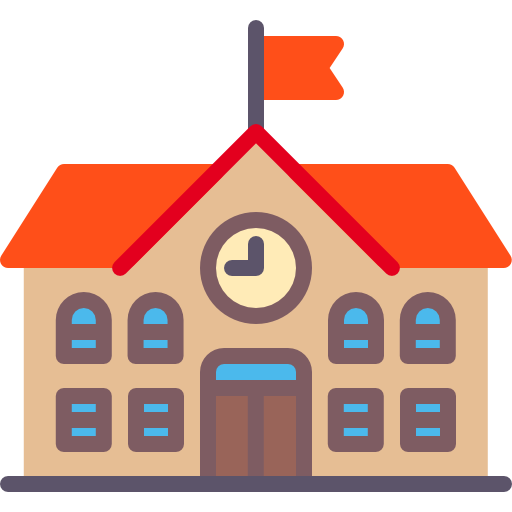
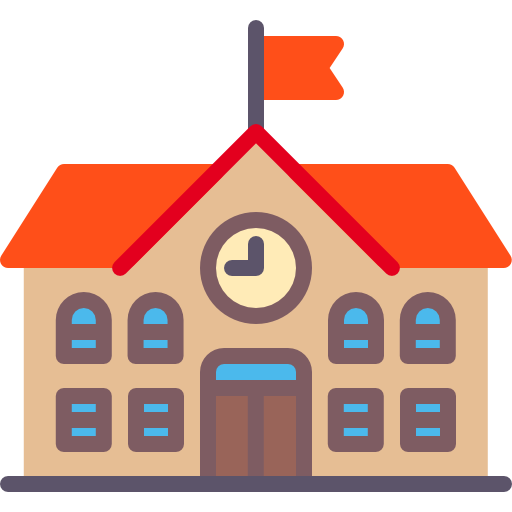
...
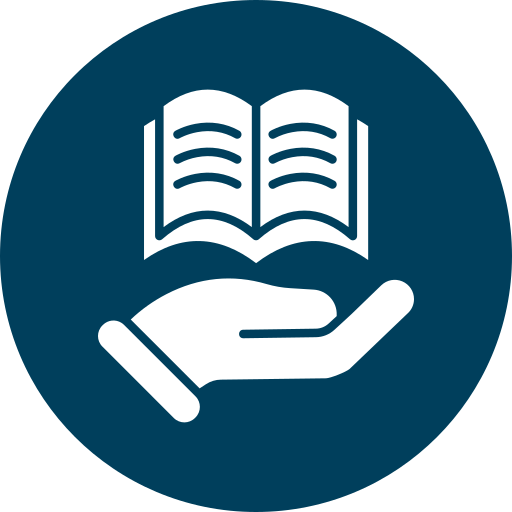
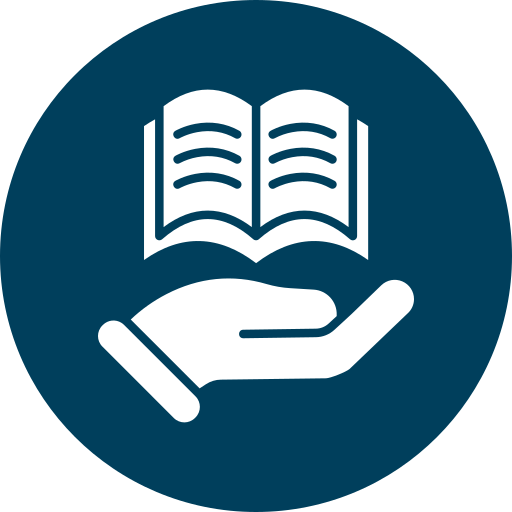
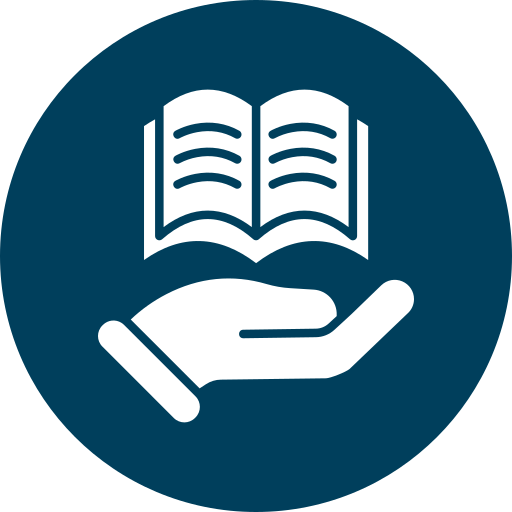
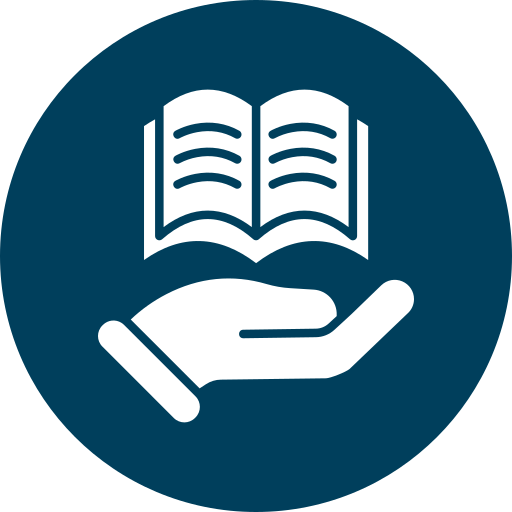
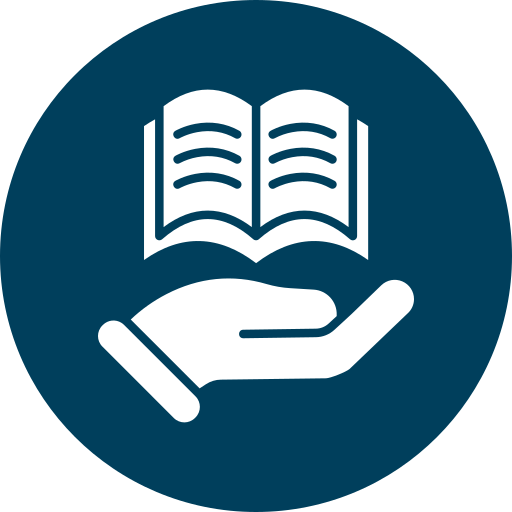

In [217]:
nash_map

In [218]:
for _, row in bus_new.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=.0001,
        color='black',
        fill=False,
        fill_color='black',
        fill_opacity=.2,
        opacity=.2,
        popup=folium.Popup(row.get('stop_desc'), max_width=200)
    ).add_to(nash_map)

In [599]:
bus_new['stop_desc'].unique()

array(['10TH AV N & HERMAN ST', '1037 12TH AVE & ARCHER ST',
       '1025 12TH AVE & ARCHER ST', '1905 S 12TH AVE & ACKLEN AVE',
       '12TH AV S & DEMONBREUN ST', '731 12TH AVE & DIVISION ST',
       '1211 12TH AVE & EDGEHILL AVE', '1181 12TH AVE & EDGEHILL AVE',
       'GRANNY WHITE PK & FERGUSON AV', '1327 12TH AVE & HORTON AVE',
       '1289 12TH AVE & HORTON AVE', '2095 S 12TH AVE & DOUGLAS AVE S',
       '12TH AV S & LINDEN AV', '12TH AV S & SWEETBRIAR AV',
       '889 12TH AVE & SOUTH ST', '907 12TH AVE & SOUTH ST',
       '1545 S 12TH AVE & WADE AVE', '1659 S 12TH AVE & WEDGEWOOD AVE',
       '1903 S 12TH AVE & ACKLEN AVE', nan, 'N 1ST ST & MAIN ST',
       '1ST ST S & MAIN ST', '20TH AV N & CHURCH ST',
       '20TH AV N & STATE ST', '20TH AV S & WEST END AV',
       '21ST AV S & ACKLEN AV', '21ST AV S & CHILDRENS WY',
       '21ST AV S & BLAIR BV', '21ST AV S & CAPERS AV',
       '21ST AV S & EDGEHILL AV', 'US HWY 431 & 21ST AVE S',
       '21ST AV S & GARLAND AV', '21ST AV S


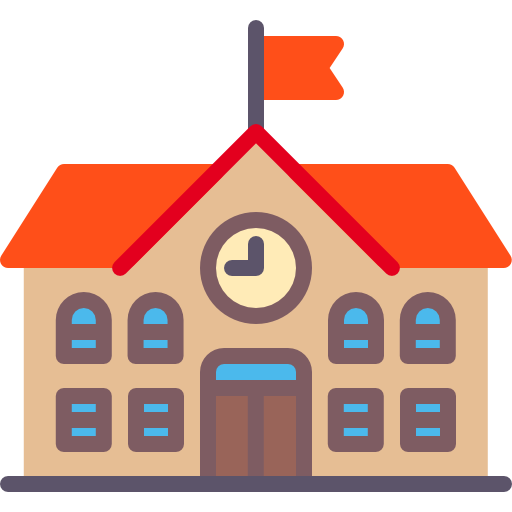
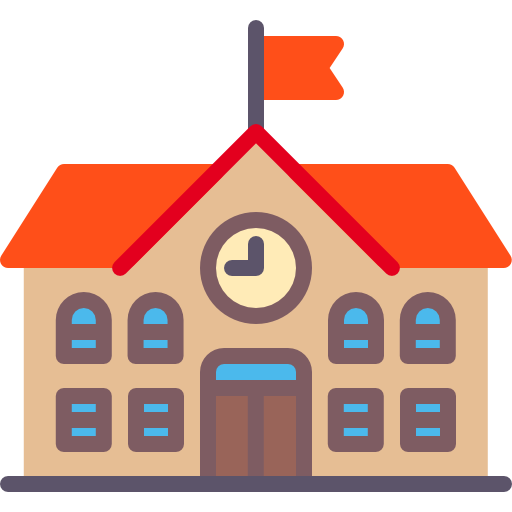
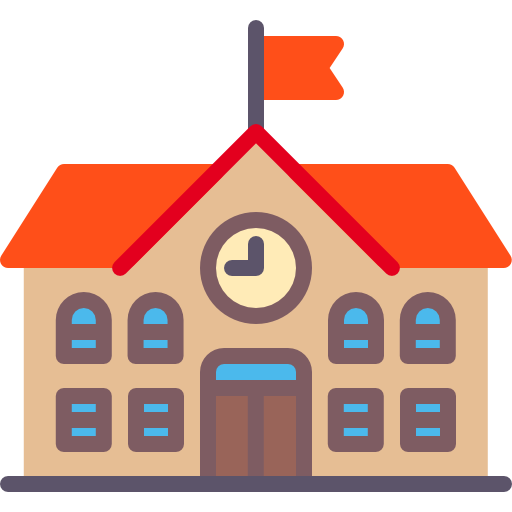
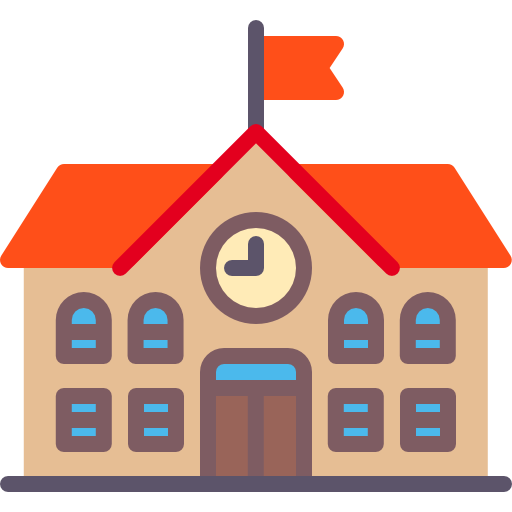
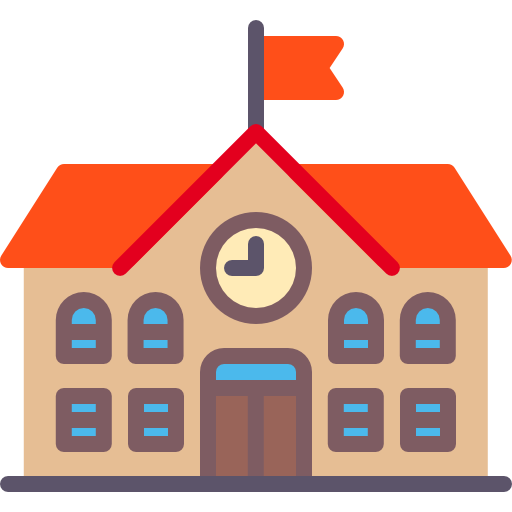
...
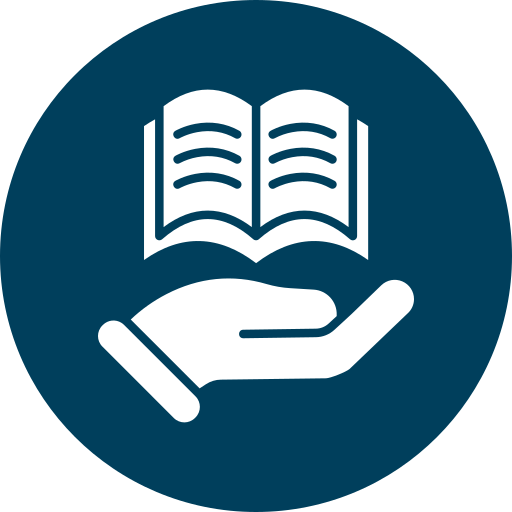
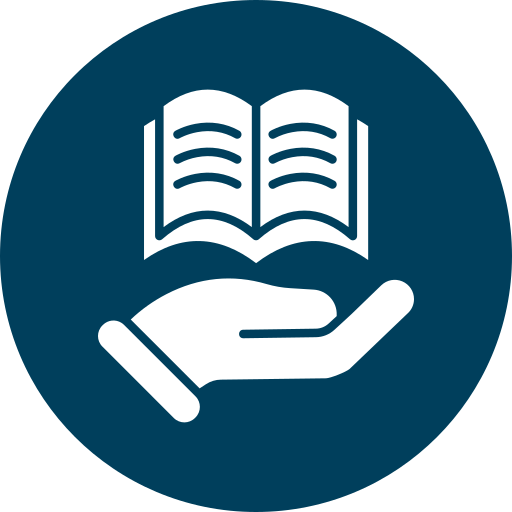
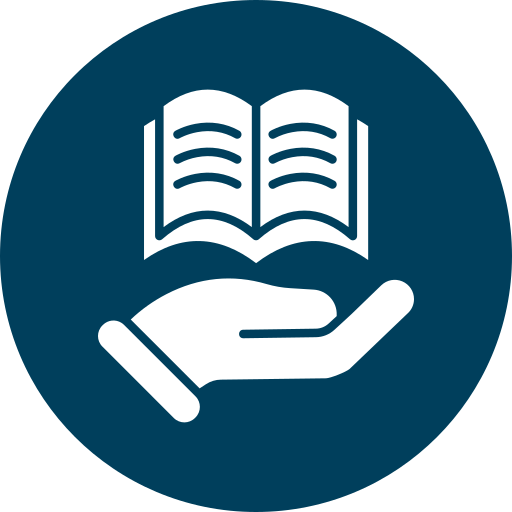
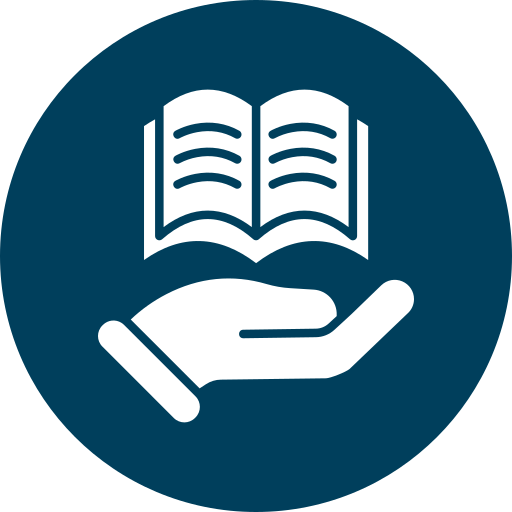
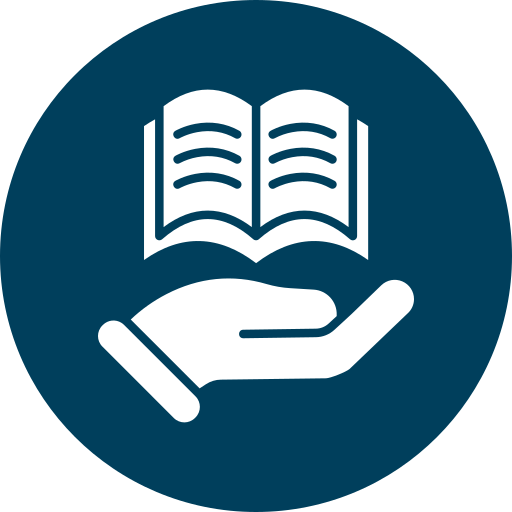

In [219]:
nash_map

In [220]:
buffers_new.geom_type.value_counts()

Polygon    118
Name: count, dtype: int64

In [221]:
#folium.GeoJson(
    #buffers_new,
    #name='1-Mile Buffers',
    #style_function=lambda feature: {
        #'fillColor': 'lightblue',
        #'color': 'blue',
        #'weight': .5,
        #'fillOpacity': 0.1,
        #'opacity': 0.1
   # }
#).add_to(nash_map)

## trying to find the distance between schools and resources - could NOT get this to work with folium

In [223]:
!pip install geopy

## Checking to see if school is within 1, 3, 5 miles from LIBRARIES

In [225]:
from geopy.distance import geodesic

def is_school_within_1mile_from_lib(school_row, libraries_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, lib_row in libraries_df.iterrows():
        lib_loc = (lib_row['lat'], lib_row['long'])
        if geodesic(school_loc, lib_loc).miles <= 1:
            return 'yes'
    return 'no'

address_df['within_1mile_library'] = address_df.apply(
    is_school_within_1mile_from_lib, 
    libraries_df=libraries, 
    axis=1
)

In [226]:
from geopy.distance import geodesic

def is_school_within_3miles_from_lib(school_row, libraries_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, lib_row in libraries_df.iterrows():
        lib_loc = (lib_row['lat'], lib_row['long'])
        if geodesic(school_loc, lib_loc).miles <= 3:
            return 'yes'
    return 'no'

address_df['within_3miles_library'] = address_df.apply(
    is_school_within_3miles_from_lib, 
    libraries_df=libraries, 
    axis=1
)

In [227]:
from geopy.distance import geodesic

def is_school_within_5miles_from_lib(school_row, libraries_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, lib_row in libraries_df.iterrows():
        lib_loc = (lib_row['lat'], lib_row['long'])
        if geodesic(school_loc, lib_loc).miles <= 5:
            return 'yes'
    return 'no'

address_df['within_5miles_library'] = address_df.apply(
    is_school_within_5miles_from_lib, 
    libraries_df=libraries, 
    axis=1
)

In [228]:
address_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,metro_dist,schbrd_dist,schbrd_mbr,long,lat,cluster_geo,cluster_name,within_1mile_library,within_3miles_library,within_5miles_library
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,33,6,Cheryl Mayes,-86.659652,36.021787,Cane Ridge,Cane Ridge,no,yes,yes
1,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,1,1,Robert Taylor,-86.818161,36.276610,Whites Creek,Whites Creek,no,no,yes
2,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,9,3,Zach Young,-86.703837,36.273773,Hunters Lane,Hunters Lane,no,yes,yes
3,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,11,4,Berthena Nabaa-Mckinney,-86.623780,36.231592,McGavock,McGavock,no,yes,yes
4,45,Bellshire Elementary,All Students,71.0,**,**,40.0,17,42.5,2.4,...,3,1,Robert Taylor,-86.762129,36.269911,Hunters Lane,Hunters Lane,no,yes,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,470,McGavock High,All Students,292.0,**,**,233.0,37,15.9,2.7,...,15,4,Berthena Nabaa-Mckinney,-86.677854,36.185450,McGavock,McGavock,no,yes,yes
114,512,Nashville School Of The Arts,All Students,4.0,*,*,3.0,*,*,*,...,16,5,Tekendrea Fayne,-86.738731,36.132342,Glencliff,Glencliff,no,yes,yes
115,555,Pearl-Cohn High,All Students,27.0,4,14.8,21.0,5,23.8,3,...,21,5,Tekendrea Fayne,-86.815458,36.164416,Pearl-Cohn,Pearl-Cohn,yes,yes,yes
116,620,Stratford STEM Magnet School,All Students,99.0,8,8.1,85.0,25,29.4,2.8,...,7,3,Zach Young,-86.718072,36.197597,Stratford,Stratford,no,yes,yes


## checking with granbery b/c it's right next to a LIBRARY but it wasn't working earlier when I used the folium method

In [230]:
granbery_check = address_df[address_df['school_name'] == 'Granbery Elementary']
print(granbery_check)


    school_number          school_name wida_student_group  wida_exit_denom  \
28            290  Granbery Elementary       All Students            137.0   

   wida_n_exit wida_pct_exit  wida_growth_standard_denom  \
28          14          10.2                        93.0   

   wida_n_met_growth_standard wida_pct_met_growth_standard wida_literacy_avg  \
28                         53                           57               2.8   

    ... metro_dist  schbrd_dist         schbrd_mbr       long        lat  \
28  ...         26            2  Rachel Anne Elrod -86.753051  36.046797   

    cluster_geo  cluster_name within_1mile_library within_3miles_library  \
28      Overton       Overton                  yes                   yes   

   within_5miles_library  
28                   yes  

[1 rows x 53 columns]


## checking to see if school is within 1, 3, 5 miles from a PARK 

In [232]:
from geopy.distance import geodesic

def is_school_within_1mile_from_park(school_row, parks_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, parks_row in parks_df.iterrows():
        park_loc = (parks_row['lat'], parks_row['long'])
        if geodesic(school_loc, park_loc).miles <= 1:
            return 'yes'
    return 'no'

address_df['within_1mile_park'] = address_df.apply(
    is_school_within_1mile_from_park, 
    parks_df=parks, 
    axis=1
)

In [233]:
from geopy.distance import geodesic

def is_school_within_3miles_from_park(school_row, parks_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, parks_row in parks_df.iterrows():
        park_loc = (parks_row['lat'], parks_row['long'])
        if geodesic(school_loc, park_loc).miles <= 3:
            return 'yes'
    return 'no'

address_df['within_3miles_park'] = address_df.apply(
    is_school_within_3miles_from_park, 
    parks_df=parks, 
    axis=1
)

In [234]:
from geopy.distance import geodesic

def is_school_within_5miles_from_park(school_row, parks_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, parks_row in parks_df.iterrows():
        park_loc = (parks_row['lat'], parks_row['long'])
        if geodesic(school_loc, park_loc).miles <= 5:
            return 'yes'
    return 'no'

address_df['within_5miles_park'] = address_df.apply(
    is_school_within_5miles_from_park, 
    parks_df=parks, 
    axis=1
)

## checking with Eakin b/c it's right next to a park

In [236]:
eakin_check = address_df[address_df['school_name'] == 'Eakin Elementary']
print(eakin_check)

    school_number       school_name wida_student_group  wida_exit_denom  \
18            195  Eakin Elementary       All Students             47.0   

   wida_n_exit wida_pct_exit  wida_growth_standard_denom  \
18           3           6.4                        18.0   

   wida_n_met_growth_standard wida_pct_met_growth_standard wida_literacy_avg  \
18                          8                         44.4               2.6   

    ...       long        lat  cluster_geo  cluster_name  \
18  ... -86.808064  36.135273    Hillsboro     Hillsboro   

    within_1mile_library  within_3miles_library  within_5miles_library  \
18                    no                    yes                    yes   

   within_1mile_park within_3miles_park within_5miles_park  
18               yes                yes                yes  

[1 rows x 56 columns]


## Is school within 1, 3, 5 miles of bus stop?

In [238]:
from geopy.distance import geodesic

def is_school_within_1mile_from_bus(school_row, bus_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, bus_row in bus_df.iterrows():
        bus_loc = (bus_row['stop_lat'], bus_row['stop_lon'])
        if geodesic(school_loc, bus_loc).miles <= 1:
            return 'yes'
    return 'no'

address_df['within_1mile_bus'] = address_df.apply(
    is_school_within_1mile_from_bus, 
    bus_df=bus_new, 
    axis=1
)

In [239]:
from geopy.distance import geodesic

def is_school_within_3miles_from_bus(school_row, bus_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, bus_row in bus_df.iterrows():
        bus_loc = (bus_row['stop_lat'], bus_row['stop_lon'])
        if geodesic(school_loc, bus_loc).miles <= 3:
            return 'yes'
    return 'no'

address_df['within_3miles_bus'] = address_df.apply(
    is_school_within_3miles_from_bus, 
    bus_df=bus_new, 
    axis=1
)

In [240]:
from geopy.distance import geodesic

def is_school_within_5miles_from_bus(school_row, bus_df):
    school_loc = (school_row['lat'], school_row['long'])
    for _, bus_row in bus_df.iterrows():
        bus_loc = (bus_row['stop_lat'], bus_row['stop_lon'])
        if geodesic(school_loc, bus_loc).miles <= 5:
            return 'yes'
    return 'no'

address_df['within_5miles_bus'] = address_df.apply(
    is_school_within_5miles_from_bus, 
    bus_df=bus_new, 
    axis=1
)

## exporting updated libraries and parks files as CSV b/c they have new columns --> now I can use in PowerBi

In [242]:
parks.to_excel('parks_updated.xlsx', index=False)

In [243]:
libraries.to_excel('libraries_updated.xlsx', index=False)

## exporting updated merged file so I can start on PowerBI

In [245]:
address_df.to_excel('merged_updated_1009.xlsx', index=False)

In [246]:
address_df

,school_number,school_name,wida_student_group,wida_exit_denom,wida_n_exit,wida_pct_exit,wida_growth_standard_denom,wida_n_met_growth_standard,wida_pct_met_growth_standard,wida_literacy_avg,...,cluster_name,within_1mile_library,within_3miles_library,within_5miles_library,within_1mile_park,within_3miles_park,within_5miles_park,within_1mile_bus,within_3miles_bus,within_5miles_bus
0,1,A. Z. Kelley Elementary,All Students,304.0,**,**,189.0,80,42.3,2.6,...,Cane Ridge,no,yes,yes,no,yes,yes,no,yes,yes
1,5,Alex Green Elementary,All Students,70.0,5,7.1,47.0,20,42.6,2.8,...,Whites Creek,no,no,yes,no,no,yes,no,yes,yes
2,10,Amqui Elementary,All Students,195.0,16,8.2,124.0,65,52.4,2.7,...,Hunters Lane,no,yes,yes,yes,yes,yes,yes,yes,yes
3,15,Andrew Jackson Elementary,All Students,45.0,**,**,32.0,16,50,2.8,...,McGavock,no,yes,yes,no,yes,yes,no,yes,yes
4,45,Bellshire Elementary,All Students,71.0,**,**,40.0,17,42.5,2.4,...,Hunters Lane,no,yes,yes,yes,yes,yes,yes,yes,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,470,McGavock High,All Students,292.0,**,**,233.0,37,15.9,2.7,...,McGavock,no,yes,yes,yes,yes,yes,yes,yes,yes
114,512,Nashville School Of The Arts,All Students,4.0,*,*,3.0,*,*,*,...,Glencliff,no,yes,yes,no,yes,yes,yes,yes,yes
115,555,Pearl-Cohn High,All Students,27.0,4,14.8,21.0,5,23.8,3,...,Pearl-Cohn,yes,yes,yes,yes,yes,yes,yes,yes,yes
116,620,Stratford STEM Magnet School,All Students,99.0,8,8.1,85.0,25,29.4,2.8,...,Stratford,no,yes,yes,yes,yes,yes,yes,yes,yes


In [247]:
address_df.columns

Index(['school_number', 'school_name', 'wida_student_group', 'wida_exit_denom',
       'wida_n_exit', 'wida_pct_exit', 'wida_growth_standard_denom',
       'wida_n_met_growth_standard', 'wida_pct_met_growth_standard',
       'wida_literacy_avg', 'wida_comp_avg', 'tvaas_overall_comp',
       'tvaas_lit_comp', 'tvaas_num_comp', 'tvaas_litandnum_comp',
       'tvaas_sci_comp', 'tvaas_ss_comp', 'merge_step1', 'letter_grade',
       'merge_step2', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'num_scoring_21orhigher', 'pct_scoring_21orhigher',
       'num_scoring_below19', 'pct_scoring_below19', 'merge_step3',
       'hs_grad_cohort_state', 'hs_grad_count_state', 'hs_grad_rate_state',
       'hs_grad_cohort_federal', 'hs_grad_count_federal',
       'hs_grad_rate_federal', 'merge_step4', 'school_type', 'short_address',
       'city', 'zip', 'metro_dist', 'schbrd_dist', 'schbrd_mbr', 'long', 'lat',
       'clu

## Cleaning - dropping some unnecessary columns, and focusing on % not 'num'

In [249]:
address_df_cleaned = address_df.drop(['wida_student_group', 'wida_exit_denom', 'wida_n_exit', 'wida_growth_standard_denom', 'wida_n_met_growth_standard', 'merge_step1', 'merge_step2', 'num_scoring_21orhigher', 'num_scoring_below19', 'merge_step3', 'merge_step4', 'cluster_geo'], axis=1)  

In [250]:
address_df_cleaned

,school_number,school_name,wida_pct_exit,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg,tvaas_overall_comp,tvaas_lit_comp,tvaas_num_comp,tvaas_litandnum_comp,...,cluster_name,within_1mile_library,within_3miles_library,within_5miles_library,within_1mile_park,within_3miles_park,within_5miles_park,within_1mile_bus,within_3miles_bus,within_5miles_bus
0,1,A. Z. Kelley Elementary,**,42.3,2.6,2.8,5.0,5.0,5.0,5.0,...,Cane Ridge,no,yes,yes,no,yes,yes,no,yes,yes
1,5,Alex Green Elementary,7.1,42.6,2.8,2.9,3.0,3.0,4.0,3.0,...,Whites Creek,no,no,yes,no,no,yes,no,yes,yes
2,10,Amqui Elementary,8.2,52.4,2.7,2.8,4.0,5.0,3.0,5.0,...,Hunters Lane,no,yes,yes,yes,yes,yes,yes,yes,yes
3,15,Andrew Jackson Elementary,**,50,2.8,3.1,3.0,1.0,5.0,3.0,...,McGavock,no,yes,yes,no,yes,yes,no,yes,yes
4,45,Bellshire Elementary,**,42.5,2.4,2.6,3.0,3.0,3.0,3.0,...,Hunters Lane,no,yes,yes,yes,yes,yes,yes,yes,yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,470,McGavock High,**,15.9,2.7,2.7,1.0,3.0,1.0,1.0,...,McGavock,no,yes,yes,yes,yes,yes,yes,yes,yes
114,512,Nashville School Of The Arts,*,*,*,*,NaN,NaN,NaN,NaN,...,Glencliff,no,yes,yes,no,yes,yes,yes,yes,yes
115,555,Pearl-Cohn High,14.8,23.8,3,2.9,1.0,4.0,1.0,1.0,...,Pearl-Cohn,yes,yes,yes,yes,yes,yes,yes,yes,yes
116,620,Stratford STEM Magnet School,8.1,29.4,2.8,2.7,1.0,1.0,4.0,3.0,...,Stratford,no,yes,yes,yes,yes,yes,yes,yes,yes


## How many schools are within 1 mile of a library?

In [252]:
address_df_cleaned['within_1mile_library'].value_counts()

within_1mile_library
no     78
yes    40
Name: count, dtype: int64

## How many schools are within 3 miles of a libary?

In [254]:
address_df_cleaned['within_3miles_library'].value_counts()

within_3miles_library
yes    110
no       8
Name: count, dtype: int64

## How many schools are within 5 miles of a libary?

In [256]:
address_df_cleaned['within_5miles_library'].value_counts()

within_5miles_library
yes    117
no       1
Name: count, dtype: int64

## How many schools are within 1 mile of a park?

In [258]:
address_df_cleaned['within_1mile_park'].value_counts()

within_1mile_park
no     73
yes    45
Name: count, dtype: int64

## How many schools are within 3 miles of a park?

In [260]:
address_df_cleaned['within_3miles_park'].value_counts()

within_3miles_park
yes    110
no       8
Name: count, dtype: int64

## How many schools are within 5 miles of a park?

In [262]:
address_df_cleaned['within_5miles_park'].value_counts()

within_5miles_park
yes    118
Name: count, dtype: int64

## How many schools are within 1 mile of a library AND a park?

In [264]:
close_to_lib_and_park = address_df_cleaned[(address_df_cleaned['within_1mile_park'] == 'yes') & (address_df['within_1mile_library'] == 'yes')]

In [265]:
close_to_lib_and_park['school_type'].value_counts()

school_type
elementary    16
middle         9
hs             4
Name: count, dtype: int64

In [266]:
close_to_lib_and_park['cluster_name'].value_counts()

cluster_name
Pearl-Cohn      9
Maplewood       4
McGavock        4
Hillsboro       4
Cane Ridge      2
Stratford       2
Hunters Lane    2
Glencliff       1
Lawson          1
Name: count, dtype: int64

## How many schools are within 1 mile of a bus stop?

In [268]:
address_df_cleaned['within_1mile_bus'].value_counts()

within_1mile_bus
yes    88
no     30
Name: count, dtype: int64

## How many schools are within 1 mile of a PARK, LIBRARY, AND BUS STOP?

In [270]:
close_to_lib_park_bus = address_df_cleaned[(address_df_cleaned['within_1mile_park'] == 'yes') & (address_df_cleaned['within_1mile_library'] == 'yes') & (address_df_cleaned['within_1mile_bus'] == 'yes')]

In [271]:
close_to_lib_park_bus['school_type'].value_counts()

school_type
elementary    15
middle         8
hs             4
Name: count, dtype: int64

## checking to make sure columns are formatted correctly

In [273]:
address_df_cleaned['within_1mile_library'].unique()

array(['no', 'yes'], dtype=object)

In [274]:
address_df_cleaned['within_1mile_park'].unique()

array(['no', 'yes'], dtype=object)

In [275]:
address_df_cleaned['within_1mile_bus'].unique()

array(['no', 'yes'], dtype=object)

In [276]:
address_df_cleaned.columns

Index(['school_number', 'school_name', 'wida_pct_exit',
       'wida_pct_met_growth_standard', 'wida_literacy_avg', 'wida_comp_avg',
       'tvaas_overall_comp', 'tvaas_lit_comp', 'tvaas_num_comp',
       'tvaas_litandnum_comp', 'tvaas_sci_comp', 'tvaas_ss_comp',
       'letter_grade', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'pct_scoring_21orhigher', 'pct_scoring_below19', 'hs_grad_cohort_state',
       'hs_grad_count_state', 'hs_grad_rate_state', 'hs_grad_cohort_federal',
       'hs_grad_count_federal', 'hs_grad_rate_federal', 'school_type',
       'short_address', 'city', 'zip', 'metro_dist', 'schbrd_dist',
       'schbrd_mbr', 'long', 'lat', 'cluster_name', 'within_1mile_library',
       'within_3miles_library', 'within_5miles_library', 'within_1mile_park',
       'within_3miles_park', 'within_5miles_park', 'within_1mile_bus',
       'within_3miles_bus', 'within_5miles_bus'],
      dtype='objec

## Creating a function to assign proximity scores 

In [278]:
def assign_proximity_scores(row):
    # library_score
    if row['within_1mile_library'] == 'yes':
        library_score = 3
    elif row['within_3miles_library'] == 'yes':
        library_score = 2
    elif row['within_5miles_library'] == 'yes':
        library_score = 1
    else:
        library_score = 0

    # park_score
    if row['within_1mile_park'] == 'yes':
        park_score = 3
    elif row['within_3miles_park'] == 'yes':
        park_score = 2
    elif row['within_5miles_park'] == 'yes':
        park_score = 1
    else:
        park_score = 0

    # bus_score
    if row['within_1mile_bus'] == 'yes':
        bus_score = 3
    elif row['within_3miles_bus'] == 'yes':
        bus_score = 2
    elif row['within_5miles_bus'] == 'yes':
        bus_score = 1
    else:
        bus_score = 0

    return pd.Series({
        'library_score': library_score,
        'park_score': park_score,
        'bus_score': bus_score,
        'total_resource_score': library_score + park_score + bus_score
    })

address_df_cleaned[['library_score', 'park_score', 'bus_score', 'total_resource_score']] = address_df_cleaned.apply(assign_proximity_scores, axis=1)

In [279]:
address_df_cleaned

,school_number,school_name,wida_pct_exit,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg,tvaas_overall_comp,tvaas_lit_comp,tvaas_num_comp,tvaas_litandnum_comp,...,within_1mile_park,within_3miles_park,within_5miles_park,within_1mile_bus,within_3miles_bus,within_5miles_bus,library_score,park_score,bus_score,total_resource_score
0,1,A. Z. Kelley Elementary,**,42.3,2.6,2.8,5.0,5.0,5.0,5.0,...,no,yes,yes,no,yes,yes,2,2,2,6
1,5,Alex Green Elementary,7.1,42.6,2.8,2.9,3.0,3.0,4.0,3.0,...,no,no,yes,no,yes,yes,1,1,2,4
2,10,Amqui Elementary,8.2,52.4,2.7,2.8,4.0,5.0,3.0,5.0,...,yes,yes,yes,yes,yes,yes,2,3,3,8
3,15,Andrew Jackson Elementary,**,50,2.8,3.1,3.0,1.0,5.0,3.0,...,no,yes,yes,no,yes,yes,2,2,2,6
4,45,Bellshire Elementary,**,42.5,2.4,2.6,3.0,3.0,3.0,3.0,...,yes,yes,yes,yes,yes,yes,2,3,3,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,470,McGavock High,**,15.9,2.7,2.7,1.0,3.0,1.0,1.0,...,yes,yes,yes,yes,yes,yes,2,3,3,8
114,512,Nashville School Of The Arts,*,*,*,*,NaN,NaN,NaN,NaN,...,no,yes,yes,yes,yes,yes,2,2,3,7
115,555,Pearl-Cohn High,14.8,23.8,3,2.9,1.0,4.0,1.0,1.0,...,yes,yes,yes,yes,yes,yes,3,3,3,9
116,620,Stratford STEM Magnet School,8.1,29.4,2.8,2.7,1.0,1.0,4.0,3.0,...,yes,yes,yes,yes,yes,yes,2,3,3,8


In [280]:
address_df_cleaned['total_resource_score'].value_counts()

total_resource_score
7    40
9    27
8    23
6    19
5     6
4     3
Name: count, dtype: int64

## Adding a high_poverty column to the merged DF (ref: https://www.tn.gov/content/dam/tn/education/esser-planning-resources/High_Poverty_Schools_TN_2021-07-30.pdf)

In [282]:
#address_df_cleaned['school_name'].unique() # making sure I use correct spelling of school names

In [283]:
high_poverty = ['Napier Elementary', 'Robert Churchwell Elementary', 'Park Avenue Elementary', 'John Early Middle', 'Ida B. Wells Elementary', 'Moses McKissack Middle', 'Haynes Middle', 'Warner Elementary', 'Cumberland Elementary', 'Pearl-Cohn High', 'Bellshire Elementary', 'Jones Elementary', 'Alex Green Elementary', 'Inglewood Elementary', 'Tom Joy Elementary', 'Whites Creek High', 'Stratford STEM Magnet School', 'Jere Baxter Middle', 'Maplewood High', 'Fall-Hamilton Elementary', 'East Nashville Middle', 'Madison Middle', 'Cockrill Elementary', 'Hattie Cotton Elementary', 'Carter-Lawrence Elementary', 'Dodson Elementary', 'Chadwell Elementary']  

address_df_cleaned['high_poverty'] = address_df_cleaned['school_name'].apply(
    lambda x: 'yes' if x in high_poverty else 'no'
)

In [284]:
address_df_cleaned['high_poverty'].value_counts()

high_poverty
no     91
yes    27
Name: count, dtype: int64

In [285]:
address_df_cleaned.columns

Index(['school_number', 'school_name', 'wida_pct_exit',
       'wida_pct_met_growth_standard', 'wida_literacy_avg', 'wida_comp_avg',
       'tvaas_overall_comp', 'tvaas_lit_comp', 'tvaas_num_comp',
       'tvaas_litandnum_comp', 'tvaas_sci_comp', 'tvaas_ss_comp',
       'letter_grade', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'pct_scoring_21orhigher', 'pct_scoring_below19', 'hs_grad_cohort_state',
       'hs_grad_count_state', 'hs_grad_rate_state', 'hs_grad_cohort_federal',
       'hs_grad_count_federal', 'hs_grad_rate_federal', 'school_type',
       'short_address', 'city', 'zip', 'metro_dist', 'schbrd_dist',
       'schbrd_mbr', 'long', 'lat', 'cluster_name', 'within_1mile_library',
       'within_3miles_library', 'within_5miles_library', 'within_1mile_park',
       'within_3miles_park', 'within_5miles_park', 'within_1mile_bus',
       'within_3miles_bus', 'within_5miles_bus', 'library_score', 'p

In [286]:
address_df_cleaned.isna().sum()

school_number                     0
school_name                       0
wida_pct_exit                     4
wida_pct_met_growth_standard      4
wida_literacy_avg                 4
wida_comp_avg                     4
tvaas_overall_comp                1
tvaas_lit_comp                    1
tvaas_num_comp                    1
tvaas_litandnum_comp              1
tvaas_sci_comp                   15
tvaas_ss_comp                    70
letter_grade                      1
act_validtests                  100
act_part_rate                   100
act_avg_eng                     100
act_avg_math                    100
act_avg_reading                 100
act_avg_sci                     100
act_avg_comp                    100
pct_scoring_21orhigher          100
pct_scoring_below19             100
hs_grad_cohort_state            100
hs_grad_count_state             100
hs_grad_rate_state              100
hs_grad_cohort_federal          100
hs_grad_count_federal           100
hs_grad_rate_federal        

In [287]:
address_df_cleaned.dtypes

school_number                     int64
school_name                      object
wida_pct_exit                    object
wida_pct_met_growth_standard     object
wida_literacy_avg                object
wida_comp_avg                    object
tvaas_overall_comp              float64
tvaas_lit_comp                  float64
tvaas_num_comp                  float64
tvaas_litandnum_comp            float64
tvaas_sci_comp                  float64
tvaas_ss_comp                   float64
letter_grade                     object
act_validtests                  float64
act_part_rate                   float64
act_avg_eng                     float64
act_avg_math                    float64
act_avg_reading                 float64
act_avg_sci                     float64
act_avg_comp                    float64
pct_scoring_21orhigher           object
pct_scoring_below19              object
hs_grad_cohort_state            float64
hs_grad_count_state              object
hs_grad_rate_state               object


In [288]:
address_df_cleaned['wida_pct_exit'].unique()

array(['**', '7.1', '8.2', '5.9', '6', '6.3', '7.6', '8.5', '5.1', '12.5',
       '8.6', '5.8', '6.4', '9', '9.8', '*', '11', '5.7', '5.4', '10.2',
       '14.3', '8', '6.9', '5.6', '8.4', '6.6', '9.5', '9.1', '9.2',
       '23.1', '8.8', '20', '10.7', '35.7', '8.3', '7.3', '13.3', '17.2',
       '15.9', '6.5', '12', nan, '7.5', '7.4', '9.9', '5', '9.6', '14.8',
       '8.1'], dtype=object)

In [289]:
address_df_cleaned['wida_pct_exit'].dtypes ##can't change to integer because I can't round up the values

dtype('O')

In [290]:
address_df_cleaned['wida_pct_met_growth_standard'].dtypes
address_df_cleaned['wida_pct_met_growth_standard'].unique()

array(['42.3', '42.6', '52.4', '50', '42.5', '90', '43.2', '38.8', '54.1',
       '53.1', '38.5', '49.6', '28.1', '48.7', '38.2', '58.6', '63.3',
       '38.9', '44.4', '59.7', '64', '51.3', '50.2', '*', '49.7', '35.7',
       '48.8', '57', '71.4', '52.7', '44.2', '56.5', '55.6', '32', '63.7',
       '52.2', '56', '53', '57.7', '56.7', '55.2', '40.8', '64.1', '72.7',
       '43.8', '34.4', '41', '57.4', '56.4', '42.9', '53.8', '40', '62.9',
       '49.1', '11.5', '22.1', '25.5', '24', '20', '31.5', nan, '30',
       '13.3', '21.2', '31.6', '19.9', '39.2', '22.4', '21.7', '15',
       '17.9', '21.3', '15.3', '13.4', '25.9', '25.1', '15.6', '15.9',
       '23.8', '29.4'], dtype=object)

In [291]:
# Convert to float64
address_df_cleaned['wida_pct_met_growth_standard'] = pd.to_numeric(
    address_df_cleaned['wida_pct_met_growth_standard'], errors='coerce'
).astype('float64')


In [292]:
address_df_cleaned['wida_pct_met_growth_standard'].unique()
address_df_cleaned['wida_pct_met_growth_standard'].dtypes

dtype('float64')

In [293]:
address_df_cleaned['wida_literacy_avg'].unique()

array(['2.6', '2.8', '2.7', '2.4', '2.5', '2.3', '2.9', '3', '*', '3.2',
       '2.1', '3.5', '3.1', '3.3', nan, '2.2'], dtype=object)

In [294]:
# Convert to float64
address_df_cleaned['wida_literacy_avg'] = pd.to_numeric(
    address_df_cleaned['wida_literacy_avg'], errors='coerce'
).astype('float64')

In [295]:
address_df_cleaned['wida_comp_avg'].unique()

array(['2.8', '2.9', '3.1', '2.6', '2.7', '2.5', '2.3', '3', '3.2', '*',
       '3.4', '3.8', '3.9', '3.7', '3.5', nan, '3.3', '2.4'], dtype=object)

In [296]:
# Convert to float64
address_df_cleaned['wida_comp_avg'] = pd.to_numeric(
    address_df_cleaned['wida_comp_avg'], errors='coerce'
).astype('float64')

In [297]:
address_df_cleaned['wida_comp_avg'].unique()

array([2.8, 2.9, 3.1, 2.6, 2.7, 2.5, 2.3, 3. , 3.2, nan, 3.4, 3.8, 3.9,
       3.7, 3.5, 3.3, 2.4])

In [298]:
address_df_cleaned['tvaas_overall_comp'].unique()

array([ 5.,  3.,  4.,  2.,  1., nan])

In [299]:
address_df_cleaned['pct_scoring_21orhigher'].unique()

array([nan, '9.7', '20', '9.8', '10.8', '**', '38', '6.6', '29.3', '20.1',
       '14', '48.6', '9.3'], dtype=object)

In [300]:
# Convert to float64
address_df_cleaned['pct_scoring_21orhigher'] = pd.to_numeric(
    address_df_cleaned['pct_scoring_21orhigher'], errors='coerce'
).astype('float64')

In [301]:
address_df_cleaned['pct_scoring_21orhigher'].unique()

array([ nan,  9.7, 20. ,  9.8, 10.8, 38. ,  6.6, 29.3, 20.1, 14. , 48.6,
        9.3])

In [302]:
address_df_cleaned['pct_scoring_below19'].unique()

array([nan, '81.7', '57.1', '81.5', '**', '45.9', '87.9', '59.5', '71.2',
       '73.3', '35.9', '81.4'], dtype=object)

In [303]:
# Convert to float64
address_df_cleaned['pct_scoring_below19'] = pd.to_numeric(
    address_df_cleaned['pct_scoring_below19'], errors='coerce'
).astype('float64')

In [304]:
address_df_cleaned['pct_scoring_below19'].unique()

array([ nan, 81.7, 57.1, 81.5, 45.9, 87.9, 59.5, 71.2, 73.3, 35.9, 81.4])

In [305]:
address_df_cleaned['hs_grad_count_state'].unique()

array([nan, '444', '**', '385', '121', '211', '284', '298', '239', '426',
       '144', '370', '142', '136', '126', '123'], dtype=object)

In [306]:
# Convert to float64
address_df_cleaned['hs_grad_count_state'] = pd.to_numeric(
    address_df_cleaned['hs_grad_count_state'], errors='coerce'
).astype('float64')

In [307]:
# Convert to float64
address_df_cleaned['hs_grad_rate_state'] = pd.to_numeric(
    address_df_cleaned['hs_grad_rate_state'], errors='coerce'
).astype('float64')

In [308]:
# Convert to float64
address_df_cleaned['hs_grad_count_federal'] = pd.to_numeric(
    address_df_cleaned['hs_grad_count_federal'], errors='coerce'
).astype('float64')

In [309]:
# Convert to float64
address_df_cleaned['hs_grad_rate_federal'] = pd.to_numeric(
    address_df_cleaned['hs_grad_rate_federal'], errors='coerce'
).astype('float64')

In [585]:
# Convert to float64
address_df_cleaned['wida_pct_exit'] = pd.to_numeric(
    address_df_cleaned['wida_pct_exit'], errors='coerce'
).astype('float64')

In [587]:
address_df_cleaned.dtypes

school_number                     int64
school_name                      object
wida_pct_exit                   float64
wida_pct_met_growth_standard    float64
wida_literacy_avg               float64
wida_comp_avg                   float64
tvaas_overall_comp              float64
tvaas_lit_comp                  float64
tvaas_num_comp                  float64
tvaas_litandnum_comp            float64
tvaas_sci_comp                  float64
tvaas_ss_comp                   float64
letter_grade                     object
act_validtests                  float64
act_part_rate                   float64
act_avg_eng                     float64
act_avg_math                    float64
act_avg_reading                 float64
act_avg_sci                     float64
act_avg_comp                    float64
pct_scoring_21orhigher          float64
pct_scoring_below19             float64
hs_grad_cohort_state            float64
hs_grad_count_state             float64
hs_grad_rate_state              float64


## Saving a DF for ONLY high_poverty 'yes' schools : high_poverty_schools

In [589]:
high_poverty_schools = address_df_cleaned[address_df_cleaned['high_poverty'] == 'yes']
high_poverty_schools.reset_index(drop=True, inplace=True)

In [591]:
high_poverty_schools_sorted_by_resource_score = high_poverty_schools.sort_values(by='total_resource_score', ascending=False)

In [593]:
high_poverty_schools_sorted_by_resource_score.columns

Index(['school_number', 'school_name', 'wida_pct_exit',
       'wida_pct_met_growth_standard', 'wida_literacy_avg', 'wida_comp_avg',
       'tvaas_overall_comp', 'tvaas_lit_comp', 'tvaas_num_comp',
       'tvaas_litandnum_comp', 'tvaas_sci_comp', 'tvaas_ss_comp',
       'letter_grade', 'act_validtests', 'act_part_rate', 'act_avg_eng',
       'act_avg_math', 'act_avg_reading', 'act_avg_sci', 'act_avg_comp',
       'pct_scoring_21orhigher', 'pct_scoring_below19', 'hs_grad_cohort_state',
       'hs_grad_count_state', 'hs_grad_rate_state', 'hs_grad_cohort_federal',
       'hs_grad_count_federal', 'hs_grad_rate_federal', 'school_type',
       'short_address', 'city', 'zip', 'metro_dist', 'schbrd_dist',
       'schbrd_mbr', 'long', 'lat', 'cluster_name', 'within_1mile_library',
       'within_3miles_library', 'within_5miles_library', 'within_1mile_park',
       'within_3miles_park', 'within_5miles_park', 'within_1mile_bus',
       'within_3miles_bus', 'within_5miles_bus', 'library_score', 'p

In [595]:
high_poverty_schools_sorted_by_resource_score

,school_number,school_name,wida_pct_exit,wida_pct_met_growth_standard,wida_literacy_avg,wida_comp_avg,tvaas_overall_comp,tvaas_lit_comp,tvaas_num_comp,tvaas_litandnum_comp,...,within_3miles_park,within_5miles_park,within_1mile_bus,within_3miles_bus,within_5miles_bus,library_score,park_score,bus_score,total_resource_score,high_poverty
13,618,Robert Churchwell Elementary,10.7,43.8,2.7,2.8,5.0,5.0,3.0,5.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
10,387,Jones Elementary,6.3,NaN,2.1,2.3,5.0,4.0,5.0,5.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
22,622,Madison Middle,NaN,22.4,2.6,2.8,5.0,5.0,5.0,5.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
21,386,John Early Middle,NaN,13.3,2.2,2.3,3.0,4.0,3.0,3.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
18,296,East Nashville Middle,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
17,35,Moses McKissack Middle,NaN,NaN,NaN,NaN,4.0,3.0,4.0,4.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
16,675,Warner Elementary,8.3,40.0,3.1,3.4,3.0,4.0,3.0,3.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
15,670,Carter-Lawrence Elementary,35.7,53.8,3.5,3.7,3.0,3.0,4.0,3.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
11,510,Napier Elementary,NaN,NaN,NaN,NaN,4.0,3.0,5.0,4.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes
12,545,Park Avenue Elementary,NaN,38.5,2.3,2.5,3.0,3.0,3.0,3.0,...,yes,yes,yes,yes,yes,3,3,3,9,yes


In [597]:
address_df_cleaned.to_excel('final_spreadsheet.xlsx', index=False)